# **Diplomatura en Ciencia de Datos, Aprendizaje Automático y sus Aplicaciones**

## **Edición 2022**

# Trabajo práctico entregable Analisis NO supervisado
**GRUPO 17**

**Balbuena, Florencia**

**Conrrero, Agustina**

**Sanchez Herrera, Carlos**

**Serrantes, Sebastian**

# Carga de Datos

In [3]:
import os

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

In [4]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns',100)
pd.set_option('display.max_rows',1000)
import itertools
import warnings
warnings.filterwarnings("ignore")
import io

In [78]:
from plotly.offline import init_notebook_mode, plot,iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler

## Comentario: El entregable debe correrse en Jupyter Notebook, de lo contrario algunos gráficos no podrían ser visualizados

In [6]:
#Carga de Datos en JUPYTER NOTEBOOK
import pandas as pd
df = pd.read_csv('players_22.csv')
players22 = df
print(df)

       sofifa_id                                         player_url  \
0         158023  https://sofifa.com/player/158023/lionel-messi/...   
1         188545  https://sofifa.com/player/188545/robert-lewand...   
2          20801  https://sofifa.com/player/20801/c-ronaldo-dos-...   
3         190871  https://sofifa.com/player/190871/neymar-da-sil...   
4         192985  https://sofifa.com/player/192985/kevin-de-bruy...   
...          ...                                                ...   
19234     261962  https://sofifa.com/player/261962/defu-song/220002   
19235     262040  https://sofifa.com/player/262040/caoimhin-port...   
19236     262760  https://sofifa.com/player/262760/nathan-logue/...   
19237     262820  https://sofifa.com/player/262820/luke-rudden/2...   
19238     264540  https://sofifa.com/player/264540/emanuel-lalch...   

               short_name                            long_name  \
0                L. Messi       Lionel Andrés Messi Cuccittini   
1          R. L

# Analisis Exploratorio

### Preparación de los datos

In [7]:
n=10000 #cantidad de jugadores a considerar

df_n=df.loc[:n] #se reduce la base a los n primeros jugadores

df_n=df_n[(df_n['overall']>70)]

skills_ratings = ['attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy', 'attacking_short_passing',
                  'attacking_volleys', 'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
                  'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_reactions',
                  'movement_balance', 'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
                  'mentality_aggression', 'mentality_interceptions', 'mentality_positioning', 'mentality_vision', 'mentality_penalties', 
                  'mentality_composure', 'defending_marking', 'defending_standing_tackle', 'defending_sliding_tackle',
                  'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning', 'goalkeeping_reflexes']
print(len(skills_ratings), 'variables numéricas de desempeño según habilidad')

#defending_marking tiene todos NaN en esta base de datos

34 variables numéricas de desempeño según habilidad


Jugador perfecto para ver a donde se ubica en nuestra visualización = MACHINE GUN

In [8]:
MachineGunDict={'short_name':'MachineGun','overall':99}
for skills in skills_ratings:
    MachineGunDict[skills]=99
    
df_n=df_n.append(MachineGunDict,ignore_index=True)

In [9]:
df_skills=df_n[skills_ratings] #base, sólo con desempeños según habilidad (numéricas)

In [10]:
df_skills=df_skills.drop(["defending_marking"], axis=1)

In [11]:
#data=[]
bool_crack=df_n["overall"] > 85 #diferenciamos a los mejores jugadores
skill_3=skills_ratings[5]
skill_4=skills_ratings[21]
print(skill_3, skill_4)

skill_dribbling mentality_interceptions


In [12]:
graf2 = go.Scatter(x=df_skills[skill_3], y=df_skills[skill_4],
                           mode='markers',
                        text=df_n.loc[:,'player_positions'], #'Height', 'Weight', 'Club', 'Age', 'Name','Position'
                           marker=dict(
                                size=5)
                           )

crack =go.Scatter(x=df_skills.loc[bool_crack,skill_3], y=df_skills.loc[bool_crack,skill_4],name='Top players',
                      text=df_n.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[graf2,crack]

layout = go.Layout(title="Visualización de la base de a dos variables numéricas",titlefont=dict(size=20),
                xaxis=dict(title=skill_3),
                yaxis=dict(title=skill_4),
                autosize=False, width=700,height=700)

fig = go.Figure(data=data, layout=layout)

In [13]:
#En Jupyter Ntb abre en otra ventana, 
plot(fig)

'temp-plot.html'

In [14]:
#data=[]
bool_crack=df_n["overall"] > 85 #diferenciamos a los mejores jugadores
skill_5=skills_ratings[27]
skill_6=skills_ratings[9]
print(skill_5, skill_6)

defending_standing_tackle skill_ball_control


In [15]:
graf3 = go.Scatter(x=df_skills[skill_5], y=df_skills[skill_6],
                           mode='markers',
                        text=df_n.loc[:,'player_positions'], #'Height', 'Weight', 'Club', 'Age', 'Name','Position'
                           marker=dict(
                                size=5)
                           )

crack =go.Scatter(x=df_skills.loc[bool_crack,skill_5], y=df_skills.loc[bool_crack,skill_6],name='Top players',
                      text=df_n.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[graf3,crack]

layout = go.Layout(title="Visualización de la base de a dos variables numéricas",titlefont=dict(size=20),
                xaxis=dict(title=skill_5),
                yaxis=dict(title=skill_6),
                autosize=False, width=700,height=700)

fig = go.Figure(data=data, layout=layout)

In [16]:
#En Jupyter Ntb abre en otra ventana, 
plot(fig)

'temp-plot.html'

In [17]:
#data=[]
bool_crack=df_n["overall"] > 85 #diferenciamos a los mejores jugadores
skill_7=skills_ratings[19]
skill_8=skills_ratings[28]
print(skill_7, skill_8)

power_long_shots defending_sliding_tackle


In [18]:
graf4 = go.Scatter(x=df_skills[skill_7], y=df_skills[skill_8],
                           mode='markers',
                        text=df_n.loc[:,'player_positions'], #'Height', 'Weight', 'Club', 'Age', 'Name','Position'
                           marker=dict(
                                size=5)
                           )

crack =go.Scatter(x=df_skills.loc[bool_crack,skill_7], y=df_skills.loc[bool_crack,skill_8],name='Top players',
                      text=df_n.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[graf4,crack]

layout = go.Layout(title="Visualización de la base de a dos variables numéricas",titlefont=dict(size=20),
                xaxis=dict(title=skill_7),
                yaxis=dict(title=skill_8),
                autosize=False, width=700,height=700)

fig = go.Figure(data=data, layout=layout)

In [19]:
#En Jupyter Ntb abre en otra ventana, 
plot(fig)

'temp-plot.html'

### Analisis visual para variables

In [20]:
columns = list(players22.columns)
print("El dataset tiene ", len(players22.columns), " columnas") #El dataset tiene muchas columnas


El dataset tiene  110  columnas


In [21]:
#Para un mejor analisis, se eliminaron las columnas que podian aportar pocos datos
#Se consideraron aquellas variables numericas que puedan mejorar el scoring de los jugadores. Se eliminaron URLs y variables categóricas de no interés.
relevant_columns=['short_name',
 'overall',
 'potential',
 'age',
 'club_jersey_number',
 'nationality_name',
 'attacking_crossing',
 'attacking_finishing',
 'attacking_heading_accuracy',
 'attacking_short_passing',
 'attacking_volleys',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_acceleration',
 'movement_sprint_speed',
 'movement_agility',
 'movement_reactions',
 'movement_balance',
 'power_shot_power',
 'power_jumping',
 'power_stamina',
 'power_strength',
 'power_long_shots',
 'mentality_aggression',
 'mentality_interceptions',
 'mentality_positioning',
 'mentality_vision',
 'mentality_penalties',
 'mentality_composure',
 'defending_marking_awareness',
 'defending_standing_tackle',
 'defending_sliding_tackle',
 'goalkeeping_diving',
 'goalkeeping_handling',
 'goalkeeping_kicking',
 'goalkeeping_positioning',
 'goalkeeping_reflexes',
 'goalkeeping_speed']
 # 'pace','shooting','passing','dribbling','defending','physic' fueron eliminados por contener muchos NaNs

In [22]:
players22_reduced = players22[relevant_columns]
players22_reduced.head()

,short_name,overall,potential,age,club_jersey_number,nationality_name,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed
0,L. Messi,93,93,34,30.0,Argentina,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN
1,R. Lewandowski,92,92,32,9.0,Poland,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN
2,Cristiano Ronaldo,91,91,36,7.0,Portugal,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN
3,Neymar Jr,91,91,29,10.0,Brazil,85,83,63,86,86,95,88,87,81,95,93,89,96,89,84,80,64,81,53,81,63,37,86,90,93,93,35,32,29,9,9,15,15,11,NaN
4,K. De Bruyne,91,91,30,17.0,Belgium,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,68,65,53,15,13,5,10,13,NaN


La variable Overall es una variable muy informativa ya que está compuesta por todas aquellas que son relevantes para el scoring. La distriubución de la misma se presenta en el siguiente histograma:

In [23]:
players22_reduced['overall'].hist(bins = 20)

<AxesSubplot:>

Además, se evaluó el mejor jugador para cada posición, teniendo en cuenta su número de camiseta. Este ranking estuvo basado en la variable overall. 

In [24]:
best_players_per_position=players22.iloc[players22.groupby(players22['club_jersey_number'])['overall'].idxmax()][['club_jersey_number','short_name','overall']]
best_players_per_position

,club_jersey_number,short_name,overall
7,1.0,M. Neuer,90
80,2.0,K. Walker,85
46,3.0,Rúben Dias,87
15,4.0,V. van Dijk,89
39,5.0,Marquinhos,87
19,6.0,J. Kimmich,89
2,7.0,Cristiano Ronaldo,91
24,8.0,T. Kroos,88
1,9.0,R. Lewandowski,92
3,10.0,Neymar Jr,91


Por otro lado, se evaluó la posibilidad de que hubiera variables que aportaran información semejante. Es por ello que, se decidió construir una tabla con valores de correlación, la cual fue ploteada en un heatmap y se procedió a eliminar variables que aportaran información semejante para no ser redundantes a la hora de calcular nuevos parámetros.

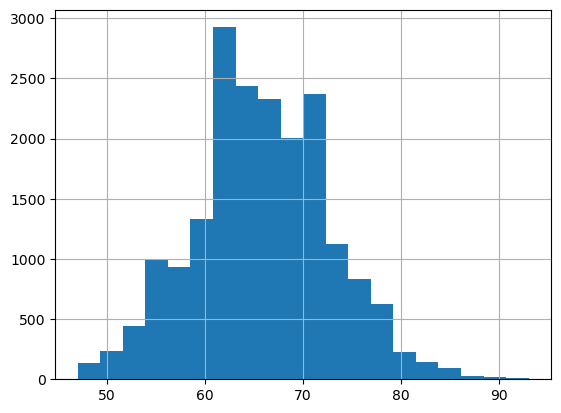

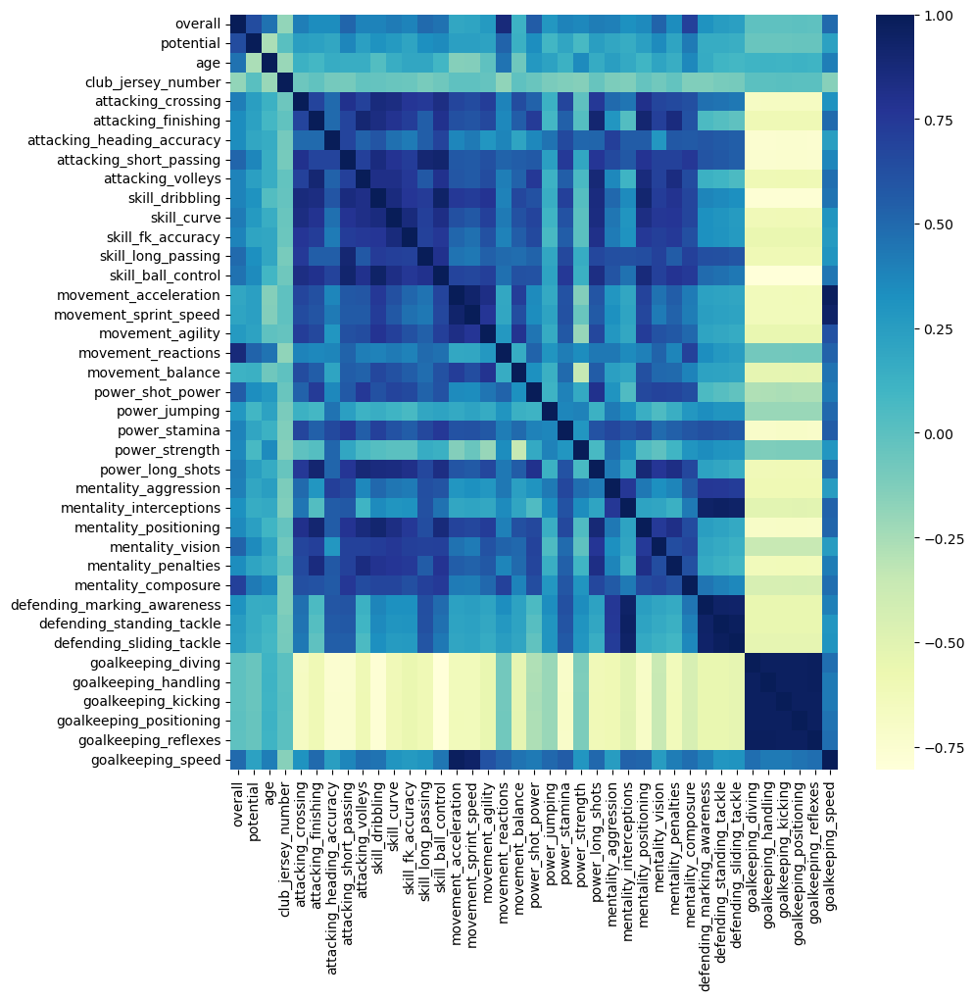

In [25]:
#Running a correlation matrix and displaying it as a heatmap
plt.figure(figsize=(10,10))
correlationHM = sns.heatmap(players22_reduced.corr(), cmap="YlGnBu", annot=False)
plt.show()

In [26]:
#Correlation Matrix
players22_reduced.corr() 

,overall,potential,age,club_jersey_number,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed
overall,1.000000,0.644275,0.459451,-0.186166,0.401356,0.338746,0.343901,0.516788,0.380942,0.384351,0.420423,0.381030,0.498216,0.460411,0.194044,0.205736,0.270279,0.871823,0.123700,0.561180,0.284689,0.385150,0.364366,0.410010,0.400161,0.316470,0.358562,0.523025,0.343690,0.708867,0.312093,0.259773,0.233589,-0.010990,-0.011080,-0.012986,-0.002485,-0.007960,0.499533
potential,0.644275,1.000000,-0.264142,0.009784,0.243757,0.230814,0.192825,0.367162,0.235766,0.311396,0.270217,0.207769,0.324791,0.347172,0.232621,0.235577,0.223385,0.522483,0.136890,0.332292,0.096992,0.199743,0.073567,0.243294,0.191501,0.157728,0.233070,0.345298,0.208062,0.426790,0.161288,0.156649,0.140869,-0.043093,-0.044989,-0.047030,-0.040184,-0.042383,0.230408
age,0.459451,-0.264142,1.000000,-0.209275,0.132175,0.088754,0.154516,0.147374,0.148109,0.030402,0.151111,0.191301,0.191542,0.092112,-0.147650,-0.139581,-0.010749,0.453298,-0.066938,0.279673,0.219382,0.131455,0.348811,0.164977,0.241968,0.179112,0.101573,0.209636,0.151951,0.359076,0.163583,0.101713,0.089482,0.109490,0.112420,0.112025,0.120686,0.111281,0.401871
club_jersey_number,-0.186166,0.009784,-0.209275,1.000000,-0.060210,-0.020882,-0.086874,-0.098454,-0.023908,-0.034639,-0.044723,-0.052058,-0.103096,-0.069398,-0.007885,-0.012471,-0.034501,-0.177832,-0.011282,-0.049082,-0.112691,-0.128311,-0.144773,-0.038571,-0.119088,-0.127988,-0.034875,-0.071939,-0.027682,-0.130962,-0.127622,-0.105673,-0.098833,0.005476,0.004407,0.006767,0.003077,0.005504,-0.152304
attacking_crossing,0.401356,0.243757,0.132175,-0.060210,1.000000,0.682982,0.493130,0.798922,0.698748,0.863184,0.840895,0.764766,0.744209,0.837386,0.682473,0.651720,0.721440,0.386875,0.642271,0.528963,0.126229,0.680769,-0.008280,0.749193,0.499103,0.446452,0.803924,0.681170,0.660510,0.627092,0.465374,0.452296,0.431552,-0.677740,-0.675595,-0.675874,-0.674395,-0.677035,0.314646
attacking_finishing,0.338746,0.230814,0.088754,-0.020882,0.682982,1.000000,0.496748,0.687100,0.900288,0.840807,0.785689,0.721055,0.544287,0.801521,0.623394,0.600298,0.667306,0.361212,0.549800,0.738760,0.089098,0.540296,0.027346,0.903280,0.295009,0.028426,0.904531,0.713155,0.852509,0.607211,0.057259,0.026031,-0.014740,-0.605657,-0.604279,-0.601335,-0.601135,-0.603013,0.492809
attacking_heading_accuracy,0.343901,0.192825,0.154516,-0.086874,0.493130,0.496748,1.000000,0.685105,0.531206,0.592342,0.466021,0.421178,0.543108,0.694926,0.368015,0.424833,0.292908,0.375754,0.207419,0.363491,0.454348,0.657005,0.512679,0.520755,0.717347,0.557749,0.561948,0.282120,0.578952,0.569060,0.591080,0.566170,0.544579,-0.748750,-0.749095,-0.745486,-0.744552,-0.748794,0.242907
attacking_short_passing,0.516788,0.367162,0.147374,-0.098454,0.798922,0.687100,0.685105,1.000000,0.705757,0.856172,0.775176,0.730313,0.898529,0.922273,0.582472,0.570126,0.625366,0.521272,0.549295,0.573172,0.236403,0.744218,0.191768,0.764475,0.658490,0.579054,0.774665,0.702265,0.697073,0.758580,0.601361,0.581733,0.547546,-0.743980,-0.741955,-0.738854,-0.738538,-0.742318,0.372554
attacking_volleys,0.380942,0.235766,0.148109,-0.023908,0.698748,0.900288,0.531206,0.705757,1.000000,0.817436,0.817390,0.753069,0.577257,0.797739,0.586531,0.564254,0.642956,0.406562,0.532501,0.749894,0.125415,0.543252,0.068351,0.880530,0.361252,0.10526

Algunas variables están muy correlacionadas con otras, lo que significa que nos brindan información similar. Consideramos que es necesario eliminarlas ya que es casi como tener informacion por duplicado. 

In [27]:
relevant_columns_nocorrelated=['attacking_crossing',
 'attacking_finishing',
 'attacking_heading_accuracy',
 'attacking_short_passing',
 'attacking_volleys',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_agility',  
 'movement_balance',
 'power_shot_power',
 'power_jumping',
 'power_stamina',
 'power_strength',
 'power_long_shots',
 'mentality_aggression',
 'mentality_positioning',
 'mentality_vision',
 'mentality_penalties',
 'mentality_composure',
 'defending_sliding_tackle',
 'goalkeeping_reflexes',
 'goalkeeping_speed']

feature_names = relevant_columns_nocorrelated

In [28]:
players22_reduced_nocorrelated = players22[relevant_columns_nocorrelated]

Se creó un dataset reducido con columnas que podrían ser de utilidad para clusterizar jugadores e identificar a los mejores. El mismo será utilizado posteriormente.

Si ploteamos todas las variables numéricas contra overall podemos ver que algunas de ellas permiten una mejor separación que otras. Es por ello que, creemos que técnicas de clsutering que incoporen más de dos dimensiones a la vez, serán sumamente útiles para crear clusters en nuestros datos. Lo mismo puede ser observado al plotear cada variable contra cada variable, como se puede observar en el siguiente gráfico: 

In [29]:
sns.pairplot(players22_reduced_nocorrelated)

Consigna


In [30]:
#P/Gráfico 2

#Elegimos un jugador
recherche_joueur=df_n["short_name"]=='L. Messi' 
#recherche_joueur=df_n["Name"]==df_n["Name"][4000] # acá podemos elegir otro 

bool_crack=df_n["overall"] > 85
bool_elecc=df_n["club_name"]=='FC Barcelona' 
bool_no_crack=df_n["overall"]<86
bool_machinegun=df_n["short_name"]=='MachineGun'

#Elegir dos números entre 0 y  de n_skills-1
skill_1=skills_ratings[6]  #6
skill_2=skills_ratings[25]  #25

In [31]:
palette=['navy','red','#A2D5F2','orange','green','pink']  

data=[]

n_crack =go.Scatter(x=df_skills.loc[bool_crack,skill_1], y=df_skills.loc[bool_crack,skill_2],name='Crack',
                      text=df_n.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=15,color='black'),
                      opacity=0.9,marker=dict(color=palette[2],size=7),mode='markers+text')

n_no_crack =go.Scatter(x=df_skills.loc[bool_no_crack,skill_1], y=df_skills.loc[bool_no_crack,skill_2],name='Average player',
                         text=df_n.loc[bool_no_crack,'short_name'],
                         opacity=0.6,marker=dict(color=palette[1],size=3),mode='markers')
n_elecc=go.Scatter(x=df_skills.loc[bool_elecc,skill_1], y=df_skills.loc[bool_elecc,skill_2],name='Elección',
                         text=df_n.loc[bool_elecc,'short_name'],
                         opacity=0.6,marker=dict(color=palette[0],size=5),mode='markers')

n_machinegun =go.Scatter(x=df_skills.loc[bool_machinegun,skill_1], y=df_skills.loc[bool_machinegun,skill_2],name='Perfect player',
                           textfont=dict(family='sans serif',size=20,color='black'),
                           opacity=0.6,marker=dict(color=palette[3],size=30),mode='markers+text')


joueur_recherche =go.Scatter(x=df_skills.loc[recherche_joueur,skill_1], y=df_skills.loc[recherche_joueur,skill_2],name='Searched player',
                           text=df_n.loc[recherche_joueur,'short_name'],
                            textfont=dict(family='sans serif',size=20,color='black'),
                           opacity=1,marker=dict(color=palette[4],size=40),mode='markers+text')

data=[n_no_crack,n_elecc
      ,n_crack,n_machinegun,joueur_recherche]

layout = go.Layout(title="Fifa Players",titlefont=dict(size=20),
                xaxis=dict(title=skill_1),
                yaxis=dict(title=skill_2),
                autosize=False, width=1000,height=1000)

fig = go.Figure(data=data, layout=layout)


In [32]:
#En Colab
#fig.show(renderer="colab")

In [33]:
#En Jupyter ntb
plot(fig) #abre y muestra en otra pestaña
#iplot(fig)  #muestra aquí

'temp-plot.html'

In [34]:
print(df_n.loc[0:43,"short_name"])

0              L. Messi
1        R. Lewandowski
2     Cristiano Ronaldo
3             Neymar Jr
4          K. De Bruyne
5              J. Oblak
6             K. Mbappé
7              M. Neuer
8         M. ter Stegen
9               H. Kane
10             N. Kanté
11           K. Benzema
12          T. Courtois
13               H. Son
14             Casemiro
15          V. van Dijk
16              S. Mané
17             M. Salah
18              Ederson
19           J. Kimmich
20              Alisson
21        G. Donnarumma
22         Sergio Ramos
23            L. Suárez
24             T. Kroos
25            R. Lukaku
26             K. Navas
27          R. Sterling
28      Bruno Fernandes
29           E. Haaland
30            S. Agüero
31            H. Lloris
32            L. Modrić
33          Á. Di María
34          W. Szczęsny
35            T. Müller
36          C. Immobile
37             P. Pogba
38          M. Verratti
39           Marquinhos
40          L. Goretzka
41            P.

In [35]:
#Elegimos un jugador
recherche_joueur=df_n["short_name"]=='L. Messi' 
#recherche_joueur=df_n["Name"]==df_n["Name"][4000] # acá podemos elegir otro 
bool_machinegun=df_n["short_name"]=='MachineGun'

bool_crack=df_n["overall"] > 85
bool_no_crack=df_n["overall"]<86
forwards=df_n.player_positions.isin(['RF', 'ST', 'LW', 'LF', 'RS', 'LS', 'RM', 'LM','RW'])
midfielders=df_n.player_positions.isin(['RCM','LCM','LDM','CAM','CDM','LAM','RDM','CM','RAM','CF'])
defenders=df_n.player_positions.isin(['RCB','CB','LCB','LB','RB','RWB','LWB'])
goalkeepers=df_n["player_positions"]=='GK'

In [36]:
#Elegir dos números entre 0 y  de n_skills-1
skill_1=skills_ratings[27]  #6
skill_2=skills_ratings[9]  #25
print(skill_1, skill_2)

defending_standing_tackle skill_ball_control


In [37]:
palette=['navy','red','#A2D5F2','orange','green','pink', "black", "yellow", "blue"]  

data=[]

n_crack =go.Scatter(x=df_skills.loc[bool_crack,skill_1], y=df_skills.loc[bool_crack,skill_2],name='Crack',
                      text=df_n.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=15,color='black'),
                      opacity=0.9,marker=dict(color=palette[2],size=7),mode='markers+text')

n_no_crack =go.Scatter(x=df_skills.loc[bool_no_crack,skill_1], y=df_skills.loc[bool_no_crack,skill_2],name='Average player',
                         text=df_n.loc[bool_no_crack,'short_name'],
                         opacity=0.6,marker=dict(color=palette[1],size=3),mode='markers')
n_elecc=go.Scatter(x=df_skills.loc[forwards,skill_1], y=df_skills.loc[forwards,skill_2],name='Forwards',
                         text=df_n.loc[forwards,'short_name'],
                         opacity=0.6,marker=dict(color=palette[0],size=5),mode='markers')
n_elecc1=go.Scatter(x=df_skills.loc[midfielders,skill_1], y=df_skills.loc[midfielders,skill_2],name='Midfielders',
                         text=df_n.loc[midfielders,'short_name'],
                         opacity=0.6,marker=dict(color=palette[7],size=5),mode='markers')
n_elecc2=go.Scatter(x=df_skills.loc[defenders,skill_1], y=df_skills.loc[defenders,skill_2],name='Defenders',
                         text=df_n.loc[defenders,'short_name'],
                         opacity=0.6,marker=dict(color=palette[6],size=5),mode='markers')
n_elecc3=go.Scatter(x=df_skills.loc[goalkeepers,skill_1], y=df_skills.loc[goalkeepers,skill_2],name='Goalkeepers',
                         text=df_n.loc[goalkeepers,'short_name'],
                         opacity=0.6,marker=dict(color=palette[5],size=5),mode='markers')


n_machinegun =go.Scatter(x=df_skills.loc[bool_machinegun,skill_1], y=df_skills.loc[bool_machinegun,skill_2],name='Perfect player',
                           textfont=dict(family='sans serif',size=20,color='black'),
                           opacity=0.6,marker=dict(color=palette[3],size=30),mode='markers+text')


joueur_recherche =go.Scatter(x=df_skills.loc[recherche_joueur,skill_1], y=df_skills.loc[recherche_joueur,skill_2],name='Searched player',
                           text=df_n.loc[recherche_joueur,'short_name'],
                            textfont=dict(family='sans serif',size=20,color='black'),
                           opacity=1,marker=dict(color=palette[4],size=40),mode='markers+text')

data=[n_no_crack,n_elecc, n_elecc1, n_elecc2, n_elecc3, n_crack,n_machinegun,joueur_recherche]

fig = go.Figure(data=data, layout=layout)

In [38]:
plot(fig) 

'temp-plot.html'

En este gráfico podemos observar la diferenciación de cuatro grupos según la posición de los jugadores. Los arqueros son los que más se diferencian ya que poseen habilidades muy diferentes a la de los jugadores en otras posiciones  como ser defensores, delanteros y mediocampistas.

In [39]:
#Elegimos un jugador
recherche_joueur=df_n["short_name"]=='L. Messi' 
#recherche_joueur=df_n["Name"]==df_n["Name"][4000] # acá podemos elegir otro 
bool_machinegun=df_n["short_name"]=='MachineGun'

bool_crack=df_n["overall"] > 85
bool_no_crack=df_n["overall"]<86
atacante=df_n.club_jersey_number.isin([9,7])
mediocampo=df_n.club_jersey_number.isin([5,10,11,8])
defensor=df_n.club_jersey_number.isin([3,2,6,4])
arquero=df_n.club_jersey_number.isin([1,12])

In [40]:
#Elegir dos números entre 0 y  de n_skills-1
skill_1=skills_ratings[27]  #6
skill_2=skills_ratings[9]  #25
print(skill_1, skill_2)

defending_standing_tackle skill_ball_control


In [41]:

palette=['navy','red','#A2D5F2','orange','green','pink', "black", "yellow", "blue"]  

data=[]

n_crack =go.Scatter(x=df_skills.loc[bool_crack,skill_1], y=df_skills.loc[bool_crack,skill_2],name='Crack',
                      text=df_n.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=15,color='black'),
                      opacity=0.9,marker=dict(color=palette[2],size=7),mode='markers+text')

n_no_crack =go.Scatter(x=df_skills.loc[bool_no_crack,skill_1], y=df_skills.loc[bool_no_crack,skill_2],name='Average player',
                         text=df_n.loc[bool_no_crack,'short_name'],
                         opacity=0.6,marker=dict(color=palette[1],size=3),mode='markers')
n_elecc=go.Scatter(x=df_skills.loc[atacante,skill_1], y=df_skills.loc[atacante,skill_2],name='Atacante',
                         text=df_n.loc[atacante,'short_name'],
                         opacity=0.6,marker=dict(color=palette[0],size=5),mode='markers')
n_elecc1=go.Scatter(x=df_skills.loc[mediocampo,skill_1], y=df_skills.loc[mediocampo,skill_2],name='Mediocampo',
                         text=df_n.loc[mediocampo,'short_name'],
                         opacity=0.6,marker=dict(color=palette[7],size=5),mode='markers')
n_elecc2=go.Scatter(x=df_skills.loc[defensor,skill_1], y=df_skills.loc[defensor,skill_2],name='Defensor',
                         text=df_n.loc[defensor,'short_name'],
                         opacity=0.6,marker=dict(color=palette[6],size=5),mode='markers')
n_elecc3=go.Scatter(x=df_skills.loc[arquero,skill_1], y=df_skills.loc[arquero,skill_2],name='Goalkeepers',
                         text=df_n.loc[arquero,'short_name'],
                         opacity=0.6,marker=dict(color=palette[5],size=5),mode='markers')



n_machinegun =go.Scatter(x=df_skills.loc[bool_machinegun,skill_1], y=df_skills.loc[bool_machinegun,skill_2],name='Perfect player',
                           textfont=dict(family='sans serif',size=20,color='black'),
                           opacity=0.6,marker=dict(color=palette[3],size=30),mode='markers+text')


joueur_recherche =go.Scatter(x=df_skills.loc[recherche_joueur,skill_1], y=df_skills.loc[recherche_joueur,skill_2],name='Searched player',
                           text=df_n.loc[recherche_joueur,'short_name'],
                            textfont=dict(family='sans serif',size=20,color='black'),
                           opacity=1,marker=dict(color=palette[4],size=40),mode='markers+text')

data=[n_no_crack,n_elecc, n_elecc1, n_elecc2, n_elecc3, n_crack,n_machinegun,joueur_recherche]

fig = go.Figure(data=data, layout=layout)

In [42]:
plot(fig) 

'temp-plot.html'

Este gráfico nos permite diferenciar grupos en relación al número de la camiseta que, a su vez, se asocia a la posición de los jugadores. Tiene información similar al gráfico anterior.

# Tecnicas de Clustering 
#### usando el Dataset Reducido

In [43]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns',100)
pd.set_option('display.max_rows',1000)
import itertools
import warnings
warnings.filterwarnings("ignore")
import io

from plotly.offline import init_notebook_mode, plot,iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization
import seaborn as sns
import plotly.express as px

from sklearn.cluster import KMeans,MeanShift
from sklearn import decomposition
from sklearn import metrics

Como se mencionó anteriormente, existen variables que están altamente correlacionadas entre ellas, por lo que creemos conveniente eliminarlas del analisis de clustering. El dataset utilizado será players22_reduced_nocorrelated que se renombrará por cuestiones de practicidad.


In [44]:
n=10000
df_n=df.loc[:n] #los primeros n
df_n=df_n[(df_n['overall']>70)] # mejores jugadores


print(len(relevant_columns_nocorrelated), 'variables numéricas: skills/habilidades')

df_skills=df_n[relevant_columns_nocorrelated] #Variables no correlacionadas entre si

25 variables numéricas: skills/habilidades


In [45]:
df_skills.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4593 entries, 0 to 4592
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   attacking_crossing          4593 non-null   int64  
 1   attacking_finishing         4593 non-null   int64  
 2   attacking_heading_accuracy  4593 non-null   int64  
 3   attacking_short_passing     4593 non-null   int64  
 4   attacking_volleys           4593 non-null   int64  
 5   skill_dribbling             4593 non-null   int64  
 6   skill_curve                 4593 non-null   int64  
 7   skill_fk_accuracy           4593 non-null   int64  
 8   skill_long_passing          4593 non-null   int64  
 9   skill_ball_control          4593 non-null   int64  
 10  movement_agility            4593 non-null   int64  
 11  movement_balance            4593 non-null   int64  
 12  power_shot_power            4593 non-null   int64  
 13  power_jumping               4593 

In [46]:
df_skills=df_skills.drop(["goalkeeping_speed"], axis=1) #Se elimina esta variable debido a que posee una numerosa cantidad de registros nulos

## Clustering con K-means

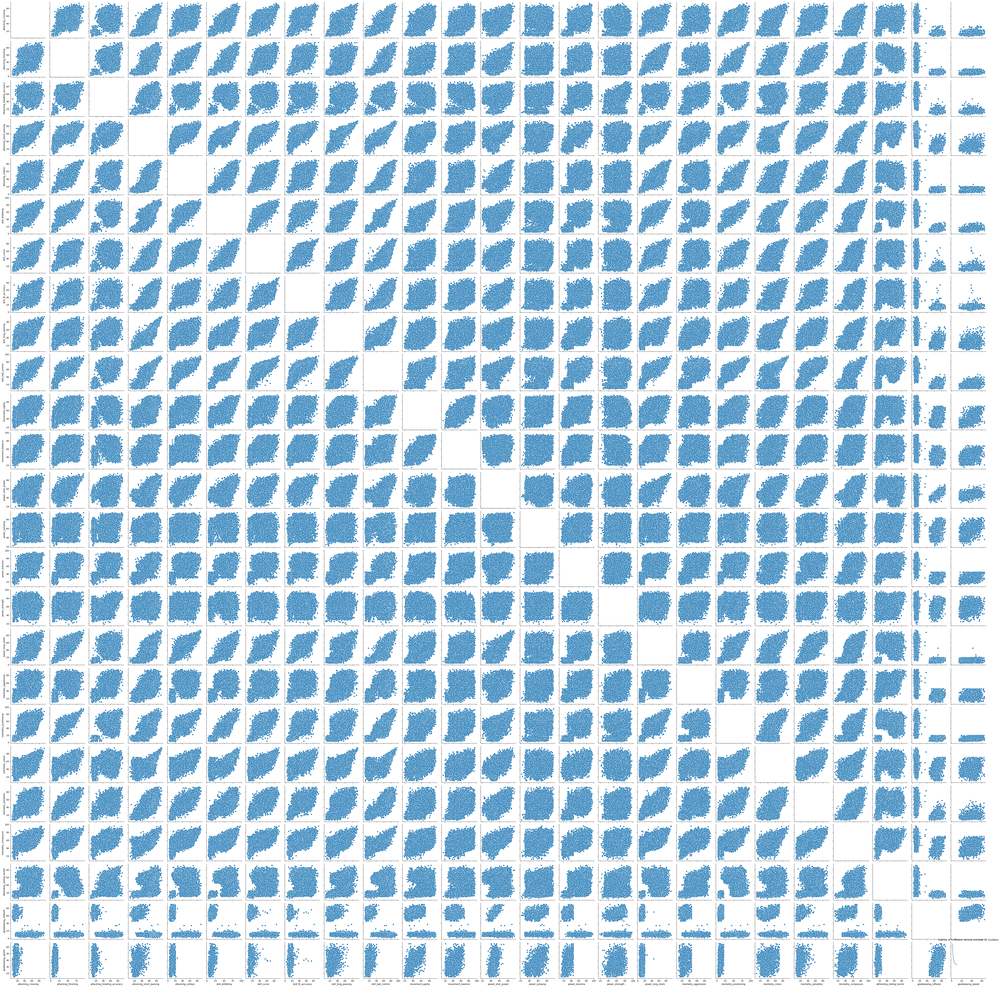

In [47]:
#Elección del numero de clusters:
#Prueba: para elegir el hiperparámetro n_clusters, variando de 2 a 11 clusters
scores = [KMeans(n_clusters=i).fit(df_skills).inertia_ for i in range(2,12)]

plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")
plt.show()

Debido a que un número de clusters óptimo debe ser aquel que sea el más bajo pero con menor inercia dentro de lo posible, consideramos que el número óptimo de clusters es 4. 

In [48]:
# Número de clusters buscado
n_clust = 4

km = KMeans(n_clusters=n_clust, random_state=10)
km.fit(df_skills) #utiliza todas las habilidades: 34 dimensiones

# Recuperacion de etiquetas
clusters = km.labels_
print('Suma de los cuadrados de las distancias al cluster=Inertia= ', km.inertia_)

Suma de los cuadrados de las distancias al cluster=Inertia=  9108496.918031977


Agregamos la variable "clusters" al dataset

In [49]:
df_clusters=df_n.copy()
df_clusters['kmeans'] = km.labels_.astype(str) #clusters
print('Kmeans encontró: ', max(km.labels_)+1, 'clusters de acuerdo a lo que nosotros establecimos')

Kmeans encontró:  4 clusters de acuerdo a lo que nosotros establecimos


In [50]:
df_clusters.bool_crack=df_clusters["overall"] > 85

df_clusters.head(3)

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,...,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,kmeans
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000.0,320000.0,34,1987-06-24,170,72,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,NaN,2021-08-10,2023.0,52,Argentina,1369.0,RW,10.0,Left,4,4,5,Medium/Low,Unique,Yes,144300000.0,"#Dribbler, #Distance Shooter, #FK Specialist, ...","Finesse Shot, Long Shot Taker (AI), Playmaker ...",85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,...,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,0
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000.0,270000.0,32,1988-08-21,185,81,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,NaN,2014-07-01,2023.0,37,Poland,1353.0,RS,9.0,Right,4,4,5,High/Medium,Unique,Yes,197200000.0,"#Aerial Threat, #Distance Shooter, #Clinical F...","Solid Player, Finesse Shot, Outside Foot Shot,...",78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,...,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png,0
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000.0,270000.0,36,1985-02-05,187,83,11.0,Manchester United,English Premier League,1.0,ST,7.0,NaN,2021-08-27,2023.0,38,Portugal,1354.0,ST,7.0,Right,4,5,5,High/Low,Unique,Yes,83300000.0,"#Aerial Threat, #Dribbler, #Distance Shooter, ...","Power Free-Kick, Flair, Long Shot Taker (AI), ...",87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,...,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1354/60.png,https://cdn.sofifa.net/flags/pt.png,0


In [51]:
df_clusters["kmeans"].max() #Los clusters fueron denominados como 0, 1, 2 y 3, como era de esperarse

'3'

A continuación se grafica el resultado de agrupar a los jugadores usando kmedias con la cantidad de clusters elegida: Visualizamos de a dos variables por vez

In [52]:
#Elijo dos números entre 0 y  de n_skills-1

skill_1=skills_ratings[27]
skill_2=skills_ratings[9]

In [53]:
#Visualizacion clusters kmeans
fig = px.scatter(df_clusters,x=skill_1, y=skill_2,color="kmeans",symbol="kmeans")

fig.add_scatter(x=df_clusters[df_clusters.bool_crack==0][skill_1],
                y=df_clusters[df_clusters.bool_crack==0][skill_2],
                text=df_clusters[df_clusters.bool_crack==0].short_name,mode='markers'
                       )

fig.add_scatter(x=df_clusters[df_clusters.bool_crack==1][skill_1],
                y=df_clusters[df_clusters.bool_crack==1][skill_2],
                text=df_clusters[df_clusters.bool_crack==1].short_name,mode='text'
                       )

plot(fig)

'temp-plot.html'

De acuerdo a estas variables elegidas para representar la información, pareciera que los clusters representan adecuadamente cómo los puntos se encuentran distribuídos. Notamos la excelente separación para el grupo de arqueros, ya que, como mencionamos anteriormente, tienen características diferentes. 

#### Analisis visual de kmeans clusters 

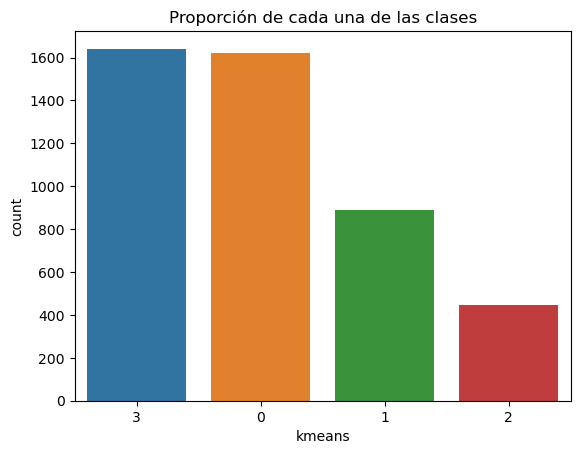

In [54]:
sns.countplot(df_clusters.kmeans, order=df_clusters.kmeans.value_counts().index)
plt.title("Proporción de cada una de las clases")
plt.show()

In [55]:
df_clusters.kmeans.value_counts().reset_index().rename(columns={'index':'cluster',
                                                                'kmeans':'cantidad'})

,cluster,cantidad
0,3,1641
1,0,1619
2,1,889
3,2,444


Notamos una proporción considerablemente menor para el cluster que creemos que corresponde a los arqueros (cluster 2)

#### IMC

In [56]:
df_clusters['imc']=df_clusters.weight_kg/(df_clusters.height_cm/100)**2

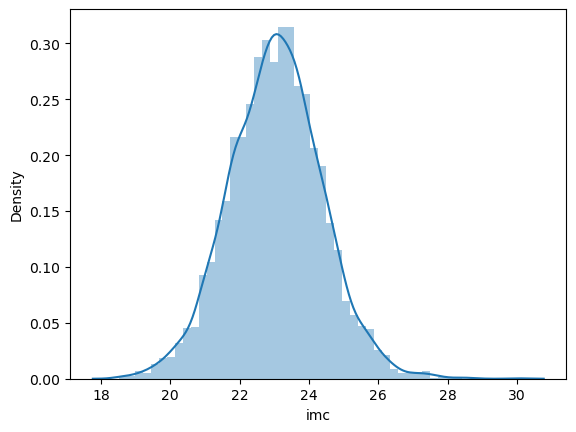

In [57]:
sns.distplot(df_clusters.imc)
plt.show()

In [58]:
df_clusters.imc.describe().reset_index().rename(columns={0:'imc'})

,index,imc
0,count,4593.000000
1,mean,23.045900
2,std,1.344802
3,min,18.513542
4,25%,22.152647
5,50%,23.040020
6,75%,23.889463
7,max,30.023244


In [59]:
from sklearn.preprocessing import KBinsDiscretizer

est = KBinsDiscretizer(n_bins=3, encode='ordinal', strategy='uniform')
df_clusters['imc_disc']=est.fit_transform(df_clusters.imc.values.reshape(-1,1))

#### Analisis de cada cluster

In [60]:
df_clusters_0=df_clusters[df_clusters["kmeans"]=='0']
print("Cluster 0")
df_clusters_0.describe()

Cluster 0


,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_level,club_jersey_number,club_contract_valid_until,nationality_id,nation_team_id,nation_jersey_number,weak_foot,skill_moves,international_reputation,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,imc,imc_disc
count,1619.000000,1619.000000,1619.000000,1.612000e+03,1615.000000,1619.000000,1619.000000,1619.000000,1615.000000,1615.000000,1615.000000,1615.000000,1619.000000,192.000000,192.000000,1619.000000,1619.000000,1619.000000,1.483000e+03,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,1619.000000,0.0,1619.000000,1619.000000
mean,215738.389129,74.899321,77.082767,1.063828e+07,30390.340557,27.255713,179.315009,74.168005,34070.951084,1.083591,18.491641,2023.154799,54.180358,8584.192708,13.968750,3.410130,3.389129,1.426807,2.066308e+07,75.518839,72.303274,68.390982,75.360099,39.654107,66.082767,65.676343,72.742434,60.886350,72.089561,67.565164,75.760346,68.412600,60.922174,63.274243,75.836319,75.983323,75.154416,76.473132,72.261890,72.666461,74.904880,66.477455,70.622607,66.668931,70.393453,58.732551,37.483014,74.282891,70.185300,67.649166,72.225448,38.517603,37.347128,32.707844,10.540457,10.585547,10.629401,10.516986,10.502779,NaN,23.036981,0.712786
std,26480.265671,3.787510,4.831967,1.633927e+07,39223.326317,4.130604,6.709556,7.010777,50025.507120,0.279089,16.815598,1.297051,40.129390,26874.721842,5.371932,0.722957,0.640056,0.750804,3.219528e+07,10.121639,5.222260,7.459056,5.139287,9.928431,9.057873,11.221514,6.129605,13.696315,5.964254,8.400434,5.821034,10.783072,13.981053,10.320879,5.030416,10.716788,10.320195,10.039526,5.968964,12.027366,6.510871,13.485971,9.327658,13.194713,6.885626,13.346694,13.331846,5.659827,7.913094,8.706260,6.682575,12.391688,13.314697,11.856184,3.053914,3.063290,3.101262,3.088145,3.132107,NaN,1.367364,0.477844
min,41.000000,71.000000,71.000000,6.000000e+05,500.000000,17.000000,158.000000,55.000000,1.000000,1.000000,2.000000,2021.000000,1.000000,1318.000000,6.000000,1.000000,2.000000,1.000000,8.780000e+05,30.000000,54.000000,43.000000,59.000000,18.000000,35.000000,22.000000,44.000000,20.000000,54.000000,38.000000,57.000000,21.000000,22.000000,25.000000,54.000000,27.000000,32.000000,30.000000,53.000000,28.000000,39.000000,30.000000,29.000000,28.000000,41.000000,24.000000,11.000000,58.000000,39.000000,30.000000,51.000000,10.000000,11.000000,10.000000,2.000000,2.000000,2.000000,3.000000,2.000000,NaN,18.513542,0.000000
25%,201876.500000,72.000000,73.000000,2.600000e+06,10000.000000,24.000000,175.000000,70.000000,219.000000,1.000000,9.000000,2022.000000,27.000000,1336.500000,9.000000,3.000000,3.000000,1.000000,4.600000e+06,70.000000,69.000000,64.000000,72.000000,32.000000,61.000000,61.000000,69.000000,50.000000,68.000000,62.000000,72.000000,62.000000,51.000000,57.000000,72.500000,70.000000,70.000000,71.000

In [61]:
df_clusters_1=df_clusters[df_clusters["kmeans"]=='1']
print("Cluster 1")
df_clusters_1.describe()

Cluster 1


,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_level,club_jersey_number,club_contract_valid_until,nationality_id,nation_team_id,nation_jersey_number,weak_foot,skill_moves,international_reputation,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,imc,imc_disc
count,889.000000,889.000000,889.000000,8.850000e+02,885.000000,889.000000,889.000000,889.000000,885.000000,885.000000,885.000000,885.000000,889.000000,96.000000,96.000000,889.000000,889.000000,889.000000,8.320000e+02,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000,0.0,889.000000,889.000000
mean,218507.309336,73.904387,76.620922,6.725819e+06,23334.011299,27.191226,185.875141,79.773903,28619.287006,1.129944,15.880226,2023.144633,47.076490,9168.864583,10.312500,2.838020,2.115861,1.263217,1.304910e+07,62.476940,40.760405,56.750281,59.842520,73.850394,75.912261,48.714286,35.014623,71.921260,67.847019,34.685039,55.777278,41.769404,36.408324,62.676040,64.192351,60.638920,63.940382,57.340832,70.281215,56.519685,55.665917,74.390326,70.458943,78.897638,39.205849,75.510686,73.491564,42.078740,49.596175,43.359955,67.204724,73.578178,75.106862,72.957255,10.463442,10.609674,10.503937,10.583802,10.383577,NaN,23.080948,0.734533
std,22161.086847,3.050416,4.346383,9.528295e+06,22503.996283,3.977342,5.569093,6.078276,47336.916916,0.339777,16.483891,1.212439,35.730012,27962.147509,8.137389,0.612073,0.320238,0.543602,1.894020e+07,12.603525,8.061697,6.499009,6.985502,4.357233,4.916551,13.950178,9.604617,7.367179,5.652791,9.026476,9.853996,11.110812,10.655264,7.981306,6.277741,12.728944,13.292696,12.024175,4.990723,12.161354,11.693812,10.546313,9.832193,7.515276,12.278365,7.295882,4.806643,12.150543,10.897972,9.355396,6.713636,5.120487,4.533515,4.696939,3.009194,3.084683,2.981972,3.046931,3.020240,NaN,1.315403,0.469029
min,120533.000000,71.000000,71.000000,3.250000e+05,500.000000,18.000000,166.000000,60.000000,1.000000,1.000000,2.000000,2021.000000,1.000000,1318.000000,2.000000,1.000000,2.000000,1.000000,4.060000e+05,28.000000,18.000000,35.000000,35.000000,30.000000,52.000000,15.000000,16.000000,37.000000,45.000000,11.000000,24.000000,18.000000,10.000000,20.000000,33.000000,29.000000,28.000000,29.000000,52.000000,27.000000,21.000000,32.000000,31.000000,44.000000,12.000000,41.000000,29.000000,12.000000,17.000000,13.000000,46.000000,30.000000,18.000000,21.000000,3.000000,3.000000,2.000000,4.000000,3.000000,NaN,18.792451,0.000000
25%,202889.000000,72.000000,73.000000,2.100000e+06,10000.000000,24.000000,183.000000,76.000000,166.000000,1.000000,4.000000,2022.000000,21.000000,1337.000000,4.000000,2.000000,2.000000,1.000000,3.800000e+06,55.000000,35.000000,52.000000,55.000000,71.000000,73.000000,38.000000,28.000000,68.000000,65.000000,28.000000,49.000000,33.000000,29.000000,58.000000,61.000000,53.000000,55.000000,51.000000,67.000000,49.000000,47.000000,70.000000,66.000000,75.00

In [62]:
df_clusters_2=df_clusters[df_clusters["kmeans"]=='2']
print("Cluster 2")
df_clusters_2.describe()

Cluster 2


,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_level,club_jersey_number,club_contract_valid_until,nationality_id,nation_team_id,nation_jersey_number,weak_foot,skill_moves,international_reputation,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,imc,imc_disc
count,444.000000,444.000000,444.000000,4.390000e+02,439.000000,444.000000,444.000000,444.000000,439.000000,439.000000,439.000000,439.000000,444.000000,78.000000,78.000000,444.000000,444.0,444.000000,4.220000e+02,0.0,0.0,0.0,0.0,0.0,0.0,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000
mean,203739.797297,75.193694,76.871622,7.091503e+06,21903.189066,29.727477,189.360360,83.738739,28027.407745,1.125285,16.785877,2023.068337,44.655405,9572.769231,10.897436,2.675676,1.0,1.362613,1.360697e+07,NaN,NaN,NaN,NaN,NaN,NaN,14.970721,12.963964,14.711712,31.277027,13.326577,15.801802,15.977477,14.871622,30.168919,22.860360,43.873874,43.754505,45.324324,70.779279,44.527027,52.972973,63.860360,33.727477,65.801802,13.666667,28.520270,19.015766,12.220721,46.750000,21.921171,52.220721,17.103604,14.761261,14.398649,75.301802,72.666667,70.439189,74.500000,76.813063,43.799550,23.349295,0.808559
std,33260.348617,4.020642,4.535210,1.342082e+07,29006.573634,4.532308,4.444883,5.852146,46981.876084,0.338238,21.115894,1.174258,31.914186,28614.572267,8.582056,0.709970,0.0,0.692787,2.717548e+07,NaN,NaN,NaN,NaN,NaN,NaN,4.323963,3.606310,4.250375,9.296584,3.825673,4.567171,5.531722,4.858188,10.701610,6.537501,9.882942,9.306208,11.836480,5.940330,10.677361,4.441157,10.845867,6.877192,9.663241,3.702439,8.128596,5.432718,3.676651,12.877023,7.934301,11.994014,5.475831,3.483821,3.317115,4.455336,4.443441,5.906602,4.609589,4.547091,9.275707,1.359294,0.447535
min,1179.000000,71.000000,71.000000,2.100000e+05,500.000000,19.000000,177.000000,67.000000,1.000000,1.000000,1.000000,2021.000000,1.000000,1318.000000,1.000000,1.000000,1.0,1.000000,2.630000e+05,NaN,NaN,NaN,NaN,NaN,NaN,6.000000,3.000000,7.000000,11.000000,4.000000,7.000000,6.000000,4.000000,9.000000,9.000000,15.000000,16.000000,19.000000,38.000000,20.000000,32.000000,31.000000,13.000000,32.000000,4.000000,11.000000,6.000000,3.000000,10.000000,8.000000,18.000000,5.000000,7.000000,7.000000,61.000000,62.000000,42.000000,62.000000,63.000000,15.000000,18.620549,0.000000
25%,189251.250000,72.000000,73.000000,1.300000e+06,7000.000000,26.000000,187.000000,80.000000,167.500000,1.000000,1.000000,2022.000000,21.000000,1337.000000,1.000000,2.000000,1.0,1.000000,2.300000e+06,NaN,NaN,NaN,NaN,NaN,NaN,12.000000,11.000000,12.000000,25.000000,11.000000,13.000000,12.000000,12.000000,22.000000,19.000000,38.000000,38.000000,36.000000,67.000000,37.000000,50.000000,58.000000,30.000000,60.000000,12.000000,22.000000,15.000000,10.000000,40.000000,16.000000,44.000000,13.000000,12.000000,12.000000,72.000000,69.000000,67.000000,71.000000,74.000000,38.000000,22.515191,1.000000
50%,206146.500000,

In [63]:
df_clusters_3=df_clusters[df_clusters["kmeans"]=='3']
print("Cluster 3")
df_clusters_3.describe()

Cluster 3


,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_level,club_jersey_number,club_contract_valid_until,nationality_id,nation_team_id,nation_jersey_number,weak_foot,skill_moves,international_reputation,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,imc,imc_disc
count,1641.000000,1641.000000,1641.000000,1.629000e+03,1629.000000,1641.000000,1641.000000,1641.000000,1629.000000,1629.000000,1629.000000,1629.000000,1641.000000,220.000000,220.000000,1641.000000,1641.000000,1641.000000,1.538000e+03,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,1641.000000,0.0,1641.000000,1641.000000
mean,215691.581353,74.956124,77.058501,9.363398e+06,29331.614487,27.444241,179.414991,73.923218,25405.924494,1.095150,18.144874,2023.202578,47.891530,12544.568182,12.422727,3.149909,2.936624,1.382693,1.796627e+07,70.538696,62.097502,70.496648,72.680073,69.667885,72.593541,68.608166,57.959781,61.828154,74.556977,54.778793,72.005484,66.290067,58.034735,70.843388,74.176112,70.732480,70.353443,72.095064,72.669104,71.476539,70.764778,69.948812,78.616088,69.626447,64.652651,73.001219,70.925046,66.469226,69.080439,57.090798,71.825716,69.297989,71.741621,69.243144,10.502742,10.576478,10.617307,10.571603,10.590494,NaN,22.953622,0.682511
std,22549.563727,3.520397,4.386397,1.290743e+07,31492.375270,3.853502,5.594553,5.837762,45407.482712,0.295598,15.754992,1.251817,35.754982,32830.085892,6.907638,0.661264,0.550725,0.640916,2.553100e+07,10.598372,7.732352,4.912914,4.659703,6.294016,6.267993,8.248616,10.008818,9.993887,4.960387,11.103853,5.684111,9.611919,12.784256,6.679362,4.773792,10.587543,11.335919,8.692833,5.218361,9.606697,8.157340,10.541836,7.929573,9.220868,9.523719,8.384146,6.901210,7.333547,7.639171,10.540094,6.297800,7.656947,6.436294,6.765226,3.055407,3.078114,3.093824,3.136317,3.103972,NaN,1.322499,0.488644
min,124635.000000,71.000000,71.000000,3.750000e+05,500.000000,18.000000,160.000000,56.000000,1.000000,1.000000,2.000000,2021.000000,1.000000,1318.000000,2.000000,1.000000,2.000000,1.000000,5.250000e+05,32.000000,37.000000,56.000000,56.000000,40.000000,45.000000,34.000000,20.000000,25.000000,58.000000,21.000000,48.000000,31.000000,22.000000,36.000000,54.000000,31.000000,30.000000,33.000000,52.000000,31.000000,28.000000,29.000000,34.000000,31.000000,30.000000,33.000000,32.000000,36.000000,39.000000,27.000000,51.000000,20.000000,29.000000,44.000000,2.000000,2.000000,2.000000,2.000000,2.000000,NaN,18.513542,0.000000
25%,201303.000000,72.000000,73.000000,2.600000e+06,11000.000000,25.000000,175.000000,70.000000,165.000000,1.000000,8.000000,2022.000000,21.000000,1336.500000,6.000000,3.000000,3.000000,1.000000,4.400000e+06,65.000000,57.000000,67.000000,70.000000,67.000000,69.000000,64.000000,51.000000,56.000000,71.000000,47.000000,68.000000,61.000000,48.000000,67.000000,71.000000,65.000000,65.000000,67.000000,

Se pueden notar diferencias entre los clusters. Por ejemplo, el cluster 2 tiene mayor altura y peso en promedio. Respecto al sueldo, el cluster 0 y 3 son más elevados. Además, la variable shooting muestra valores muy diferentes para el cluster 0, 1 y 3 y valores nulos para el cluster 2 (ya que se trata de arqueros. 
Por otro lado, hay variables que se muestran semejantes como la edad y el overall, por lo que quizás, no fueron tan efectivas a la hora de clusterizar nuestro set de datos. 

### Relacion de clusters con variables categóricas
#### Posicion

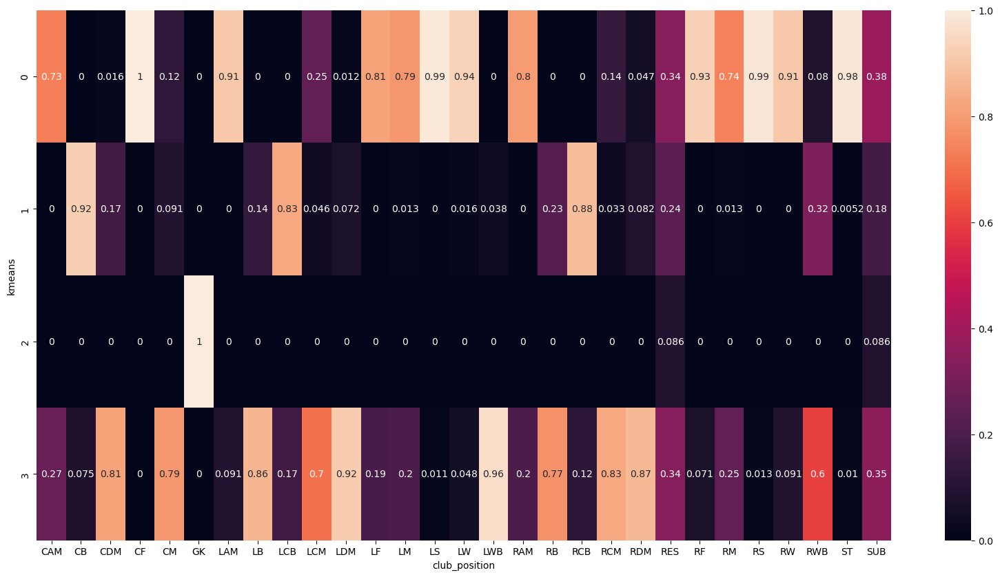

In [64]:
plt.figure(figsize=(20,10))
sns.heatmap(pd.crosstab(df_clusters.kmeans, df_clusters.club_position, normalize='columns'),annot=True)
plt.show()


Con el heatmap anterior se confirma que el cluster 2 está conformado por un casi 100% de arqueros. Por otro lado, los defensores (ej. RCB, CB) se encontraron en mayor proporción en el grupo 1, mientras que la mayor proporción de mediocampistas (ej. CM, RCM, LDM), fueron incluidos en el grupo 3. Finalmente, los delanteros (ej. RAM, ST, LS) se encontraron en una proporción mayor en el cluster 0.

#### Club

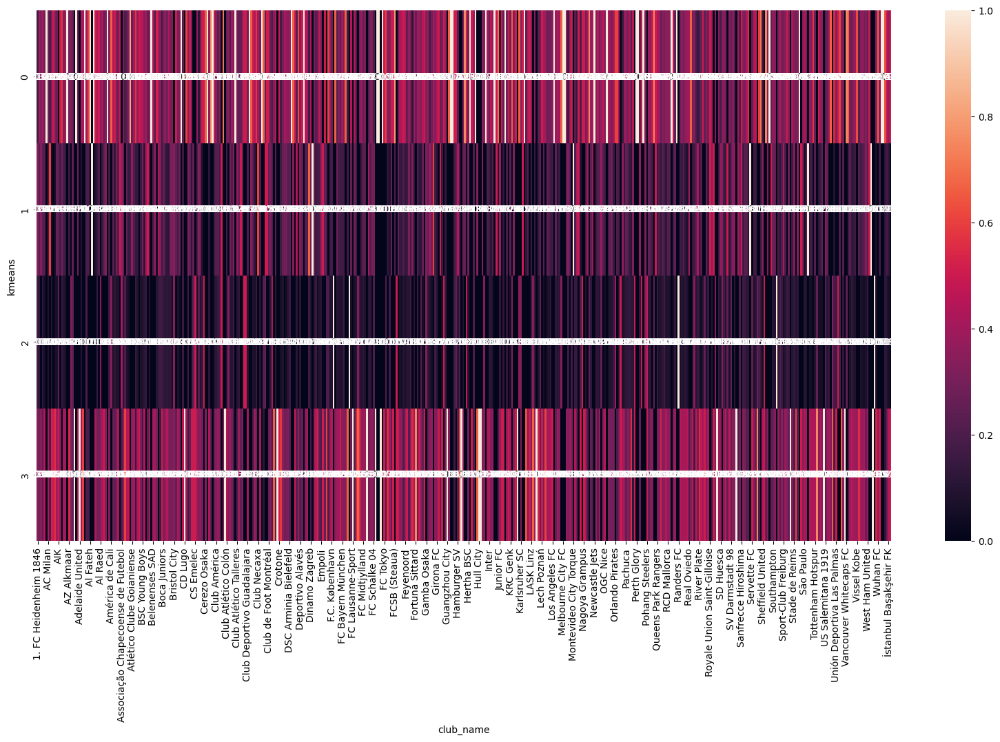

In [65]:
plt.figure(figsize=(20,10))
sns.heatmap(pd.crosstab(df_clusters.kmeans, df_clusters.club_name, normalize="columns"),annot=True)
plt.show()

En el gráfico anterior se pretendía mostrar una asociación de ciertos clubs a nuestros clusters. Lamentablemente, este gráfico no es muy informativo debido a la alta cantidad de datos. 

#### Nacionalidad

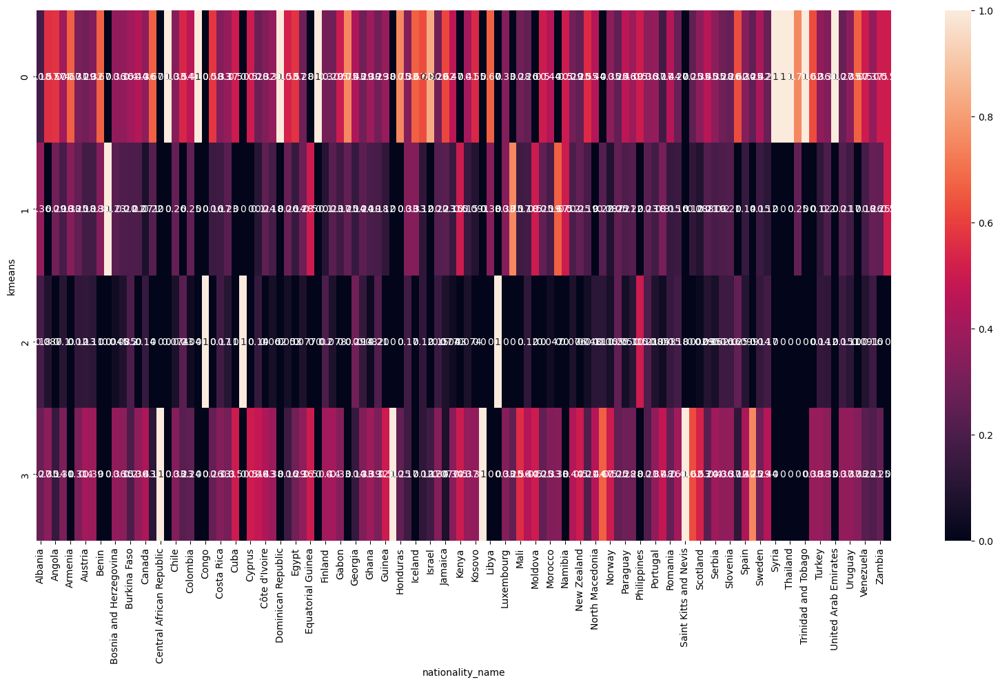

In [66]:
plt.figure(figsize=(20,10))
sns.heatmap(pd.crosstab(df_clusters.kmeans, df_clusters.nationality_name, normalize="columns"),annot=True)
plt.show()

Lo que más rescatamos de la gráfica anterior es que determinados países aportan jugadores solamente a uno de los clusters.

#### Numero de camiseta

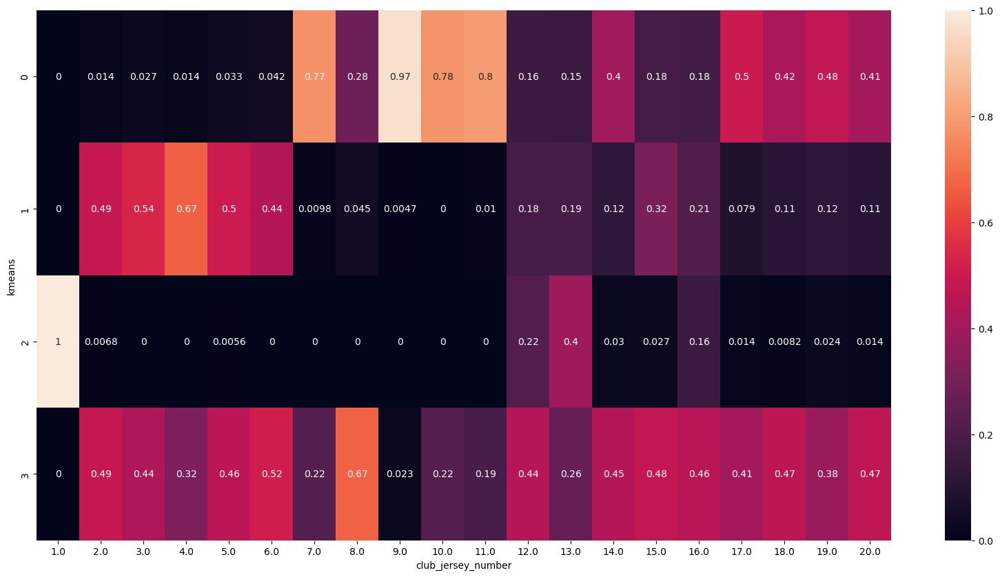

In [67]:
plt.figure(figsize=(20,10))
sns.heatmap(pd.crosstab(df_clusters[df_clusters["club_jersey_number"]<=20]["kmeans"], df_clusters[df_clusters["club_jersey_number"]<=20]["club_jersey_number"], normalize="columns"),annot=True)
plt.show()

Por último, tambien se puede observar que hay determinados números de camiseta asociados a determinados clusters. El caso más notorio es el de la camiseta 1 asociada al cluster 2 (arqueros)

### Grafico de Silueta

Automatically created module for IPython interactive environment
Para n_clusters = 2 El silhouette_score promedio es : 0.6073131135576896
Para n_clusters = 3 El silhouette_score promedio es : 0.36375535940133463
Para n_clusters = 4 El silhouette_score promedio es : 0.26363734323814225
Para n_clusters = 5 El silhouette_score promedio es : 0.2602299520773529
Para n_clusters = 6 El silhouette_score promedio es : 0.23636695640462912


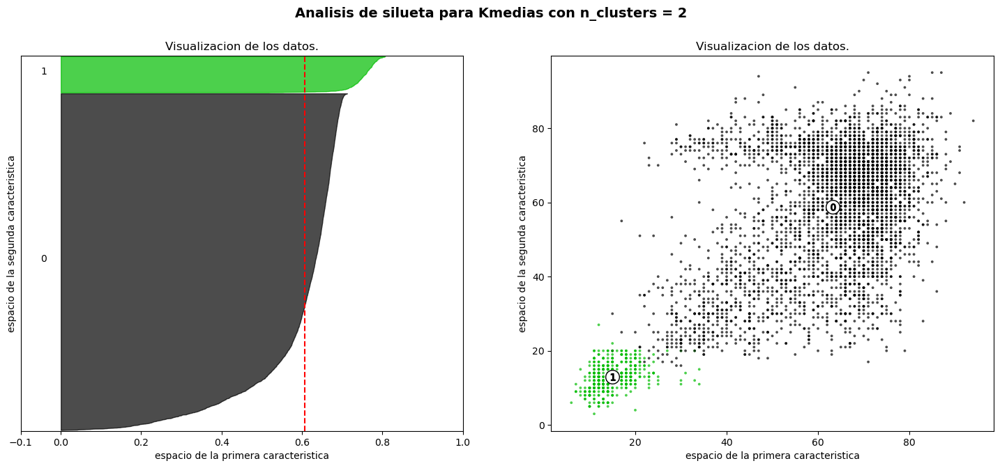

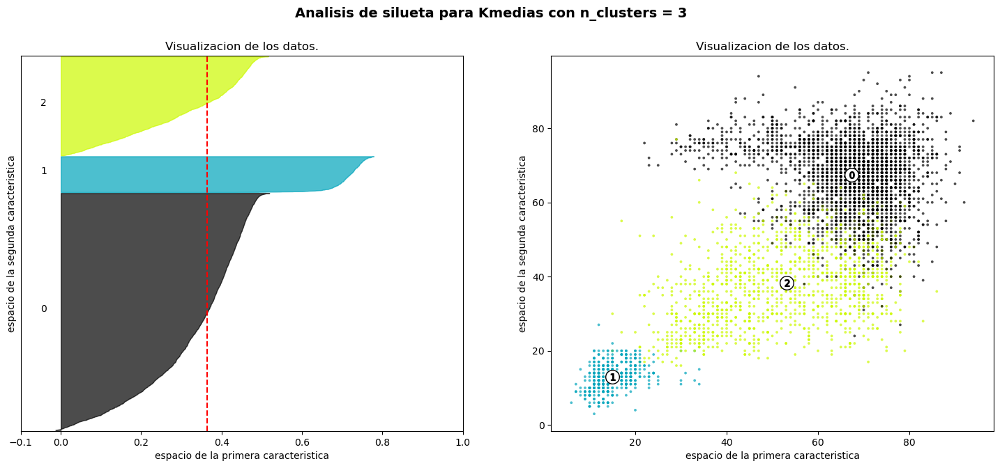

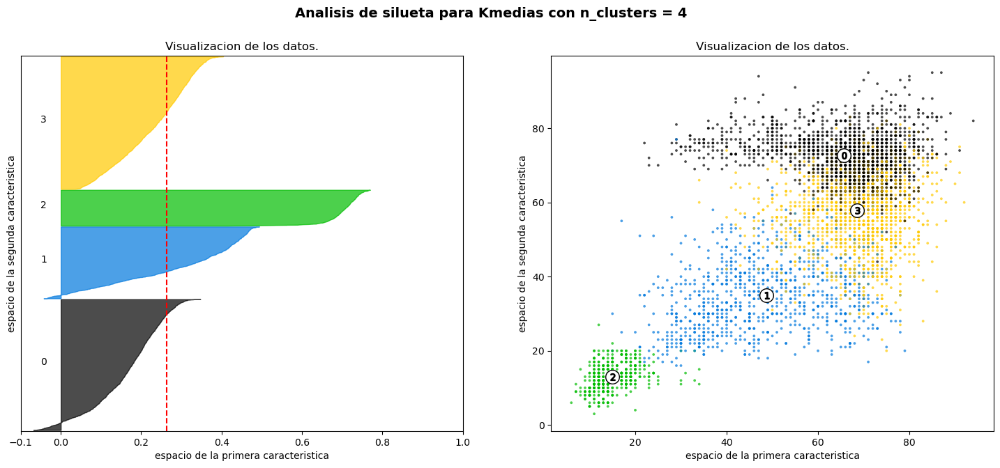

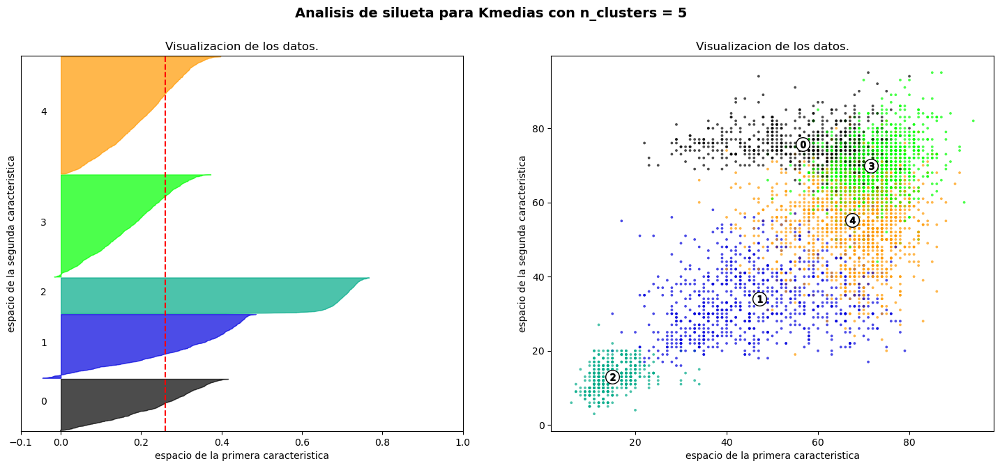

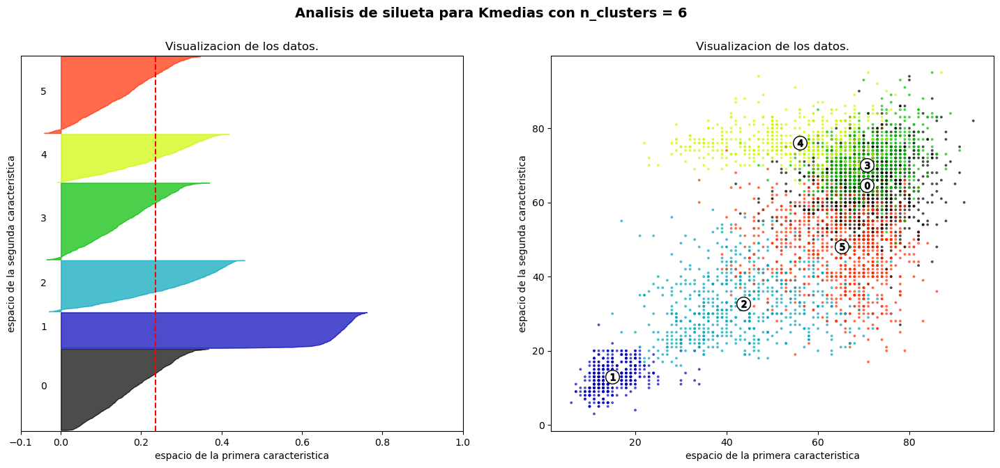

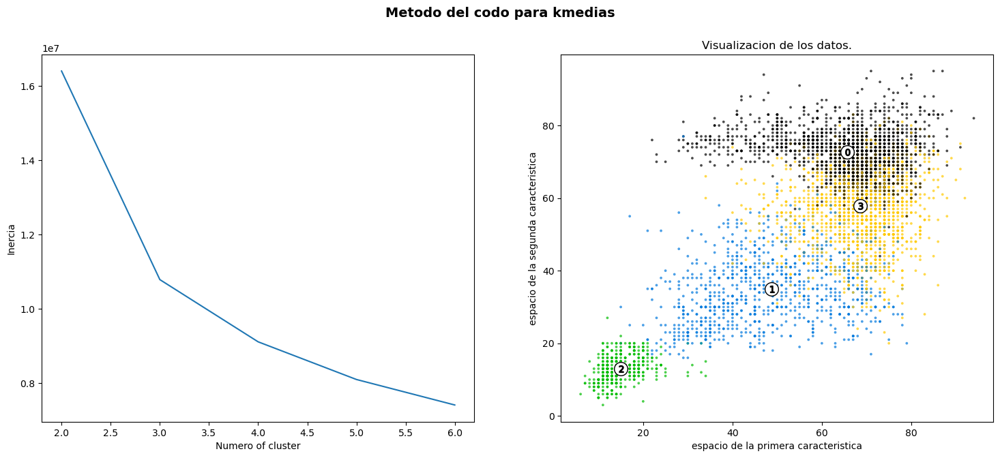

In [68]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)

X=df_skills

range_n_clusters = [2,3, 4, 5, 6]
sse ={}
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)
    sse[n_clusters] = clusterer.inertia_

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("Para n_clusters =", n_clusters,
          "El silhouette_score promedio es :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Visualizacion de los datos.")
    ax1.set_xlabel("espacio de la primera caracteristica")
    ax1.set_ylabel("espacio de la segunda caracteristica")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])


    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X.iloc[:, 0], X.iloc[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("Visualizacion de los datos.")
    ax2.set_xlabel("espacio de la primera caracteristica")
    ax2.set_ylabel("espacio de la segunda caracteristica")

    plt.suptitle(("Analisis de silueta para Kmedias "
                  "con n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    #plt.savefig("kmeans_%d" % n_clusters, dpi=300)

plt.show()

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(18, 7)
plt.suptitle(("Metodo del codo para kmedias "),
                 fontsize=14, fontweight='bold')
ax1.plot(list(sse.keys()), list(sse.values()))
ax1.set_xlabel("Numero of cluster")
ax1.set_ylabel("Inercia")

clusterer = KMeans(n_clusters=4, random_state=10)
cluster_labels = clusterer.fit_predict(X)
    
colors = cm.nipy_spectral(cluster_labels.astype(float) / 4)
ax2.scatter(X.iloc[:, 0], X.iloc[:, 1], marker='.', s=30, lw=0, alpha=0.7,c=colors, edgecolor='k')

# Labeling the clusters
centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
ax2.scatter(centers[:, 0], centers[:, 1], marker='o',c="white", alpha=1, s=200, edgecolor='k')

for i, c in enumerate(centers):
    ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,s=50, edgecolor='k')

ax2.set_title("Visualizacion de los datos.")
ax2.set_xlabel("espacio de la primera caracteristica")
ax2.set_ylabel("espacio de la segunda caracteristica")

#plt.savefig("kmeans_elbow", dpi=300)
plt.show()

#### Conclusiones generales Kmeans

Los gráficos mostrados en el inciso anterior, obtenidos a partir de la clusterización por kmeans, permite dilucidar que existe un cluster que se diferencia significativamente del resto. Como se menciono a lo largo del trabajo práctico, este cluster pertenece a los arqueros, ya que los mismos poseen habilidades significativamente diferente al resto de los jugadores, quienes no presentan una distinción tan clara entre ellos. Si bien los 3 clusters restantes (excluyendo al cluster 2) no se diferencian perfectamente, se pueden detetcar asociaciones importantes entre ellos al correlacionarlo con la variable que indica la posición de juego (defensor, mediocampista y delantero). 

## Clustering con MeanShift

Los clusters encontrados por MeanShift en el dataset crudo fueron 4593 (datos no mostrados), esto puede ser posible porque el dataset no estaba escalado. Si bien es redundante, ya que las variables estan entre 0-100, escalar el dataset fue una solución, encontrándose 2 clusters como se muesta a continuación:

In [79]:
#Escalado de dataset
df_skills2_minmax = df_skills2.copy()

min_max = MinMaxScaler()
df_skills2_minmax = min_max.fit_transform(df_skills2_minmax)
df_skills2_minmax

array([[0.89772727, 1.        , 0.73255814, ..., 0.14285714, 0.13333333,
        0.06818182],
       [0.73863636, 1.        , 0.96511628, ..., 0.10989011, 0.06666667,
        0.09090909],
       [0.92045455, 1.        , 0.96511628, ..., 0.14285714, 0.13333333,
        0.10227273],
       ...,
       [0.72727273, 0.63043478, 0.48837209, ..., 0.0989011 , 0.14444444,
        0.07954545],
       [0.65909091, 0.77173913, 0.75581395, ..., 0.13186813, 0.11111111,
        0.06818182],
       [0.57954545, 0.63043478, 0.54651163, ..., 0.08791209, 0.04444444,
        0.07954545]])

In [83]:
ms = MeanShift(bandwidth=1, bin_seeding=True)

ms.fit(df_skills2_minmax)

clusters2 = ms.labels_
cluster_centers = ms.cluster_centers_

labels_unique = np.unique(clusters2)
n_clusters_ = len(labels_unique)

print("Cantidad de clusters encontrados por Mean Shift : %d" % n_clusters_)

Cantidad de clusters encontrados por Mean Shift : 2


In [84]:
df_clusters['meanshift'] = ms.labels_.astype(str) #clusters

In [86]:
#Graficamos los resultados:

skill_1=skills_ratings[27]
skill_2=skills_ratings[9]

fig = px.scatter(df_clusters,x=skill_1, y=skill_2,color="meanshift",symbol="meanshift")

fig.add_scatter(x=df_clusters[df_clusters.bool_crack==0][skill_1],
                y=df_clusters[df_clusters.bool_crack==0][skill_2],
                text=df_clusters[df_clusters.bool_crack==0].short_name,mode='markers'
                       )

fig.add_scatter(x=df_clusters[df_clusters.bool_crack==1][skill_1],
                y=df_clusters[df_clusters.bool_crack==1][skill_2],
                text=df_clusters[df_clusters.bool_crack==1].short_name,mode='text'
                       )

plot(fig)

'temp-plot.html'

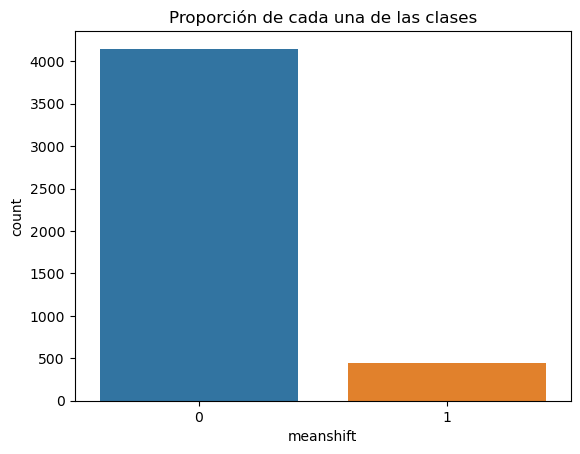

In [87]:
sns.countplot(df_clusters.meanshift, order=df_clusters.meanshift.value_counts().index)
plt.title("Proporción de cada una de las clases")
plt.show() ## Existe un desbalance entre las clases


In [88]:

df_clusters.meanshift.value_counts().reset_index().rename(columns={'index':'cluster',
                                                                'meanshift':'cantidad'})

,cluster,cantidad
0,0,4149
1,1,444


#### Análisis descriptivo por clusters

In [90]:
df_clusters_0=df_clusters[df_clusters.meanshift=='0']
df_clusters_0.describe()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_level,club_jersey_number,club_contract_valid_until,nationality_id,nation_team_id,nation_jersey_number,weak_foot,skill_moves,international_reputation,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,imc,imc_disc
count,4149.000000,4149.000000,4149.000000,4.126000e+03,4129.000000,4149.000000,4149.000000,4149.000000,4129.000000,4129.000000,4129.000000,4129.00000,4149.000000,508.000000,508.000000,4149.000000,4149.000000,4149.000000,3.853000e+03,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,4149.000000,0.0,4149.000000,4149.000000
mean,216313.168233,74.708604,76.974211,9.295740e+06,28460.208283,27.316462,180.760183,75.272355,29483.871640,1.098087,17.795108,2023.17147,50.170885,10409.805118,12.608268,3.184623,2.937334,1.374307,1.794247e+07,70.754640,61.508074,66.729573,70.975175,58.852254,70.764040,63.201494,58.811762,63.623283,72.156423,55.462762,69.993492,61.864305,54.527597,66.139793,72.684743,70.618703,70.852736,70.642082,71.998554,68.736081,69.145095,69.545915,73.749096,70.458906,61.440347,67.971077,58.425404,64.292119,65.336708,58.268739,70.991564,58.204146,59.041456,55.782357,10.509038,10.587129,10.597734,10.552904,10.511931,NaN,23.013432,0.705471
std,24104.093958,3.558734,4.559905,1.384182e+07,33294.129103,3.990511,6.611560,6.789298,47816.616952,0.299901,16.360393,1.26144,37.646845,29794.177370,6.753047,0.709248,0.725235,0.670299,2.728174e+07,11.913889,13.640753,8.265726,8.034317,17.219780,8.262508,13.289735,16.474623,11.968137,6.058567,15.607495,10.231067,14.810134,16.011222,9.346395,6.894291,12.505532,12.154810,12.335646,5.552762,12.867098,11.182331,12.143295,9.746792,11.608657,15.098060,12.813198,19.358418,14.558547,11.863563,13.219581,6.833195,18.420200,19.817969,20.502796,3.044388,3.073032,3.072792,3.097952,3.097525,NaN,1.339341,0.480599
min,41.000000,71.000000,71.000000,3.250000e+05,500.000000,17.000000,158.000000,55.000000,1.000000,1.000000,2.000000,2021.00000,1.000000,1318.000000,2.000000,1.000000,2.000000,1.000000,4.060000e+05,28.000000,18.000000,35.000000,35.000000,18.000000,35.000000,15.000000,16.000000,20.000000,45.000000,11.000000,24.000000,18.000000,10.000000,20.000000,33.000000,27.000000,28.000000,29.000000,52.000000,27.000000,21.000000,29.000000,29.000000,28.000000,12.000000,24.000000,11.000000,12.000000,17.000000,13.000000,46.000000,10.000000,11.000000,10.000000,2.000000,2.000000,2.000000,2.000000,2.000000,NaN,18.513542,0.000000
25%,201860.000000,72.000000,73.000000,2.500000e+06,10000.000000,24.000000,176.000000,70.000000,175.000000,1.000000,8.000000,2022.00000,21.000000,1337.000000,7.000000,3.000000,2.000000,1.000000,4.300000e+06,64.000000,53.000000,62.000000,67.000000,42.000000,66.000000,57.000000,48.000000,55.000000,68.000000,44.000000,66.000000,53.000000,41.000000,61.000000,69.000000,64.000000,65.000000,6

In [91]:
df_clusters_1=df_clusters[df_clusters.meanshift=='1']
df_clusters_1.describe()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_level,club_jersey_number,club_contract_valid_until,nationality_id,nation_team_id,nation_jersey_number,weak_foot,skill_moves,international_reputation,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,imc,imc_disc
count,444.000000,444.000000,444.000000,4.390000e+02,439.000000,444.000000,444.000000,444.000000,439.000000,439.000000,439.000000,439.000000,444.000000,78.000000,78.000000,444.000000,444.0,444.000000,4.220000e+02,0.0,0.0,0.0,0.0,0.0,0.0,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000,444.000000
mean,203739.797297,75.193694,76.871622,7.091503e+06,21903.189066,29.727477,189.360360,83.738739,28027.407745,1.125285,16.785877,2023.068337,44.655405,9572.769231,10.897436,2.675676,1.0,1.362613,1.360697e+07,NaN,NaN,NaN,NaN,NaN,NaN,14.970721,12.963964,14.711712,31.277027,13.326577,15.801802,15.977477,14.871622,30.168919,22.860360,43.873874,43.754505,45.324324,70.779279,44.527027,52.972973,63.860360,33.727477,65.801802,13.666667,28.520270,19.015766,12.220721,46.750000,21.921171,52.220721,17.103604,14.761261,14.398649,75.301802,72.666667,70.439189,74.500000,76.813063,43.799550,23.349295,0.808559
std,33260.348617,4.020642,4.535210,1.342082e+07,29006.573634,4.532308,4.444883,5.852146,46981.876084,0.338238,21.115894,1.174258,31.914186,28614.572267,8.582056,0.709970,0.0,0.692787,2.717548e+07,NaN,NaN,NaN,NaN,NaN,NaN,4.323963,3.606310,4.250375,9.296584,3.825673,4.567171,5.531722,4.858188,10.701610,6.537501,9.882942,9.306208,11.836480,5.940330,10.677361,4.441157,10.845867,6.877192,9.663241,3.702439,8.128596,5.432718,3.676651,12.877023,7.934301,11.994014,5.475831,3.483821,3.317115,4.455336,4.443441,5.906602,4.609589,4.547091,9.275707,1.359294,0.447535
min,1179.000000,71.000000,71.000000,2.100000e+05,500.000000,19.000000,177.000000,67.000000,1.000000,1.000000,1.000000,2021.000000,1.000000,1318.000000,1.000000,1.000000,1.0,1.000000,2.630000e+05,NaN,NaN,NaN,NaN,NaN,NaN,6.000000,3.000000,7.000000,11.000000,4.000000,7.000000,6.000000,4.000000,9.000000,9.000000,15.000000,16.000000,19.000000,38.000000,20.000000,32.000000,31.000000,13.000000,32.000000,4.000000,11.000000,6.000000,3.000000,10.000000,8.000000,18.000000,5.000000,7.000000,7.000000,61.000000,62.000000,42.000000,62.000000,63.000000,15.000000,18.620549,0.000000
25%,189251.250000,72.000000,73.000000,1.300000e+06,7000.000000,26.000000,187.000000,80.000000,167.500000,1.000000,1.000000,2022.000000,21.000000,1337.000000,1.000000,2.000000,1.0,1.000000,2.300000e+06,NaN,NaN,NaN,NaN,NaN,NaN,12.000000,11.000000,12.000000,25.000000,11.000000,13.000000,12.000000,12.000000,22.000000,19.000000,38.000000,38.000000,36.000000,67.000000,37.000000,50.000000,58.000000,30.000000,60.000000,12.000000,22.000000,15.000000,10.000000,40.000000,16.000000,44.000000,13.000000,12.000000,12.000000,72.000000,69.000000,67.000000,71.000000,74.000000,38.000000,22.515191,1.000000
50%,206146.500000,

El análisis descriptivo que se observa muestra una diferencia entre sueldo, peso y altura entre clusters. El cluster 0 contiene jugadores con un sueldo promedio mayor, altura y peso menor. 

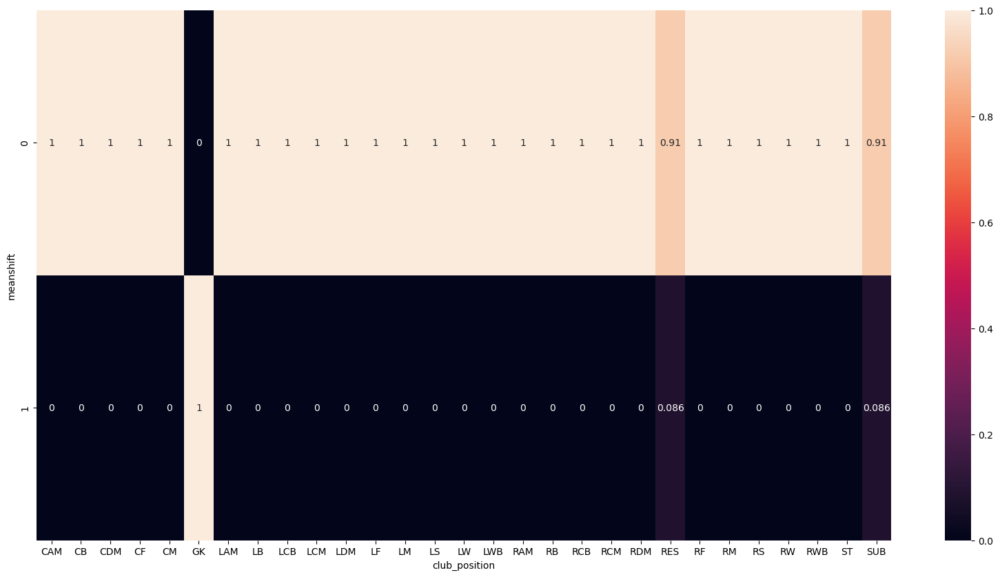

In [96]:
#Heatmap Posiciones
plt.figure(figsize=(20,10))
sns.heatmap(pd.crosstab(df_clusters.meanshift, df_clusters.club_position, normalize="columns"),annot=True)
plt.show()

Por otro lado, se puede observar que el clsuter 1 está compuesto casi en su totalidad por arqueros (GK), mientas que el cluster 1 por el resto de las posiciones.

<Figure size 2000x1000 with 0 Axes>

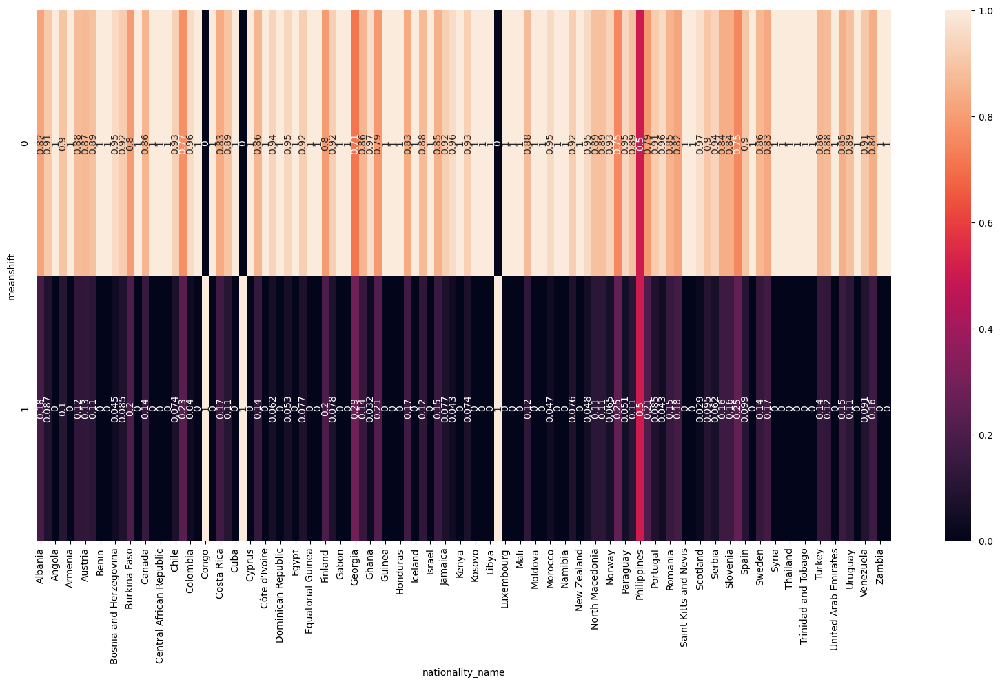

In [100]:
#Heatmap Nacionalidad
plt.figure(figsize=(20,10))
sns.heatmap(pd.crosstab(df_clusters.meanshift, df_clusters.nationality_name, normalize="columns"),annot=True,annot_kws={'rotation':90})
plt.show()

Como se puede ver en el heatmap anterior, existe una correlación entre la nacionalidad de los jugadores y los clusters a los que pertenecen.

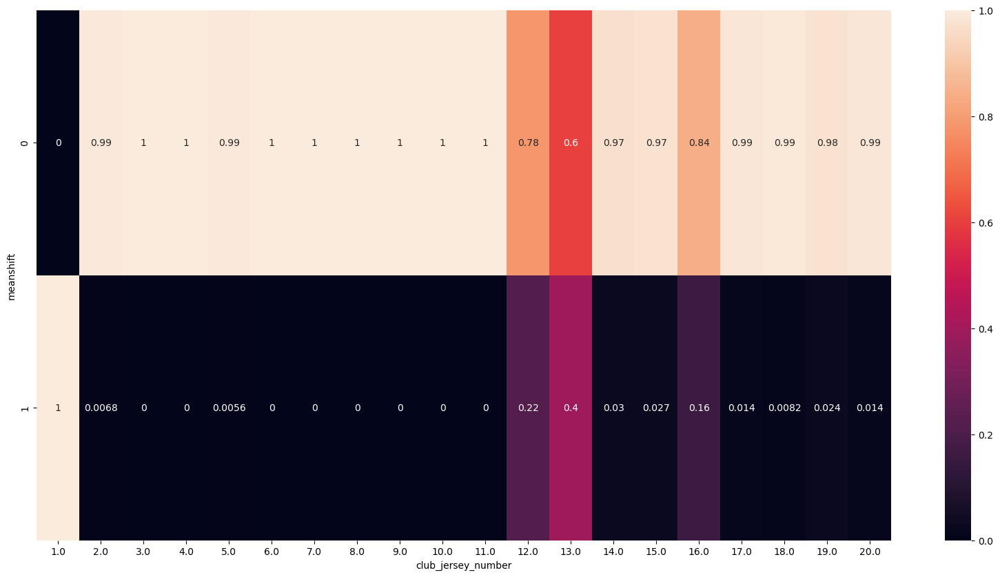

In [107]:
#heatmap camiseta
plt.figure(figsize=(20,10))
sns.heatmap(pd.crosstab(df_clusters[df_clusters["club_jersey_number"]<=20]["meanshift"], df_clusters[df_clusters["club_jersey_number"]<=20]["club_jersey_number"], normalize="columns"),annot=True)
plt.show()

A su vez, esta información también nos sirve para corroborar que la totalidad de arqueros (camiseta 1) pertenecen al cluster 2. Sin embargo, una minoría de otras posiciones tambien son parte de este cluster.
Lo mismo se observó con la posición de los jugadores, esto es debido a la estrecha relación entre ambas variables.

Como conclusión general, este metodo dio 2 clusters: arqueros y no arqueros. Por lo cual, sería interesante aplicarlo filtrando a los arqueros para evaluar la performance del clustering sin tener esta variable.

### K-means sin arqueros

In [120]:
n=10000
df_n=df.loc[:n]
df_n=df_n[(df_n["player_positions"]!='GK')&(df_n['overall']>69)]

skills_ratings = ['attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy', 'attacking_short_passing',
                  'attacking_volleys', 'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
                  'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_reactions',
                  'movement_balance', 'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
                  'mentality_aggression', 'mentality_interceptions', 'mentality_positioning', 'mentality_vision', 'mentality_penalties', 
                  'mentality_composure', 'defending_standing_tackle', 'defending_sliding_tackle']

df_skills=df_n[skills_ratings]

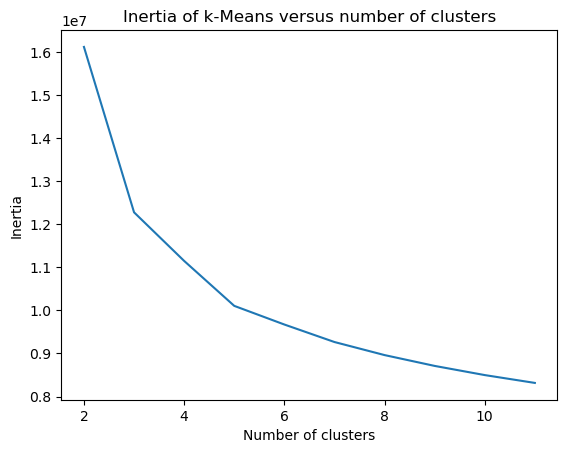

In [121]:
#Elección del parámetro n clusters
scores = [KMeans(n_clusters=i).fit(df_skills).inertia_ for i in range(2,12)]

plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")
plt.show()

Se eligen 3 clusters ya que este número presenta una inercia baja. 

In [122]:
# Número de clusters buscado
n_clust = 3

km = KMeans(n_clusters=n_clust, random_state=10)
km.fit(df_skills)

# Recuperacion de etiquetas
clusters = km.labels_

In [123]:
df_clusters_sa=df_n.copy()
df_clusters_sa['kmeans'] = km.labels_.astype(str) #clusters
print('Kmeans encontró: ', max(km.labels_)+1, 'clusters, nosotros forzamos la cantidad')

Kmeans encontró:  3 clusters, nosotros forzamos la cantidad


In [124]:
df_clusters_sa.bool_crack=df_clusters_sa["overall"] > 85

In [125]:
#Elijo dos números entre 0 y  de n_skills-1
skill_1=skills_ratings[27]
skill_2=skills_ratings[9]

In [128]:
fig = px.scatter(df_clusters_sa,x=skill_1, y=skill_2,color="kmeans",symbol="kmeans")

fig.add_scatter(x=df_clusters_sa[df_clusters_sa.bool_crack==0][skill_1],
                y=df_clusters_sa[df_clusters_sa.bool_crack==0][skill_2],
                text=df_clusters_sa[df_clusters_sa.bool_crack==0].short_name,mode='markers'
                       )

fig.add_scatter(x=df_clusters_sa[df_clusters_sa.bool_crack==1][skill_1],
                y=df_clusters_sa[df_clusters_sa.bool_crack==1][skill_2],
                text=df_clusters_sa[df_clusters_sa.bool_crack==1].short_name,mode='text'
                       )

plot(fig)

'temp-plot.html'

#### Analisis de clusters: proporcion

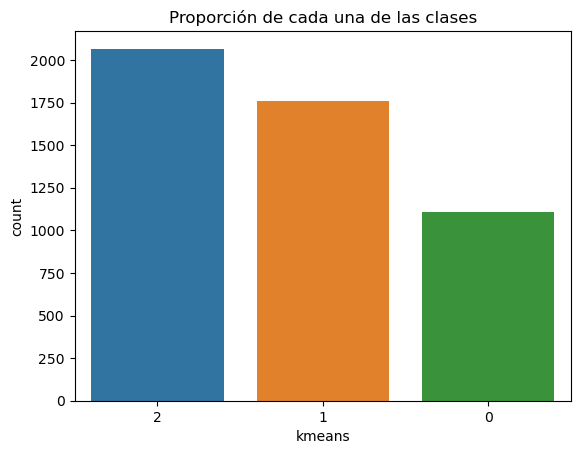

In [127]:
sns.countplot(df_clusters_sa.kmeans, order=df_clusters_sa.kmeans.value_counts().index)
plt.title("Proporción de cada una de las clases")
plt.show() ## Existe un desbalance entre las clases


In [129]:
df_clusters_sa.kmeans.value_counts().reset_index().rename(columns={'index':'cluster',
                                                                'kmeans':'cantidad'})

,cluster,cantidad
0,2,2066
1,1,1759
2,0,1110


#### Analisis de clusters: analisis descriptivo

In [130]:
df_clusters_0=df_clusters_sa[df_clusters_sa["kmeans"]=='0']
df_clusters_0.describe()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_level,club_jersey_number,club_contract_valid_until,nationality_id,nation_team_id,nation_jersey_number,weak_foot,skill_moves,international_reputation,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed
count,1110.000000,1110.000000,1110.000000,1.106000e+03,1106.000000,1110.000000,1110.000000,1110.000000,1106.000000,1106.00000,1106.000000,1106.000000,1110.000000,99.000000,99.000000,1110.000000,1110.000000,1110.000000,1.044000e+03,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,1110.000000,0.0
mean,219240.801802,73.149550,75.878378,5.782256e+06,20305.063291,27.218018,185.603604,79.527027,32788.338156,1.16094,15.477396,2023.083183,48.297297,10043.939394,10.212121,2.854955,2.115315,1.225225,1.114296e+07,62.187387,40.681081,56.396396,59.479279,73.006306,75.463964,48.606306,35.073874,70.978378,67.294595,34.509009,55.308108,41.693694,36.511712,62.165766,63.800000,60.542342,63.495495,57.571171,69.558559,56.775676,55.243243,73.783784,70.304505,78.451351,39.154955,74.751351,72.701802,42.009910,49.323423,43.412613,66.484685,72.713514,74.308108,72.069369,10.495495,10.643243,10.503604,10.630631,10.390991,NaN
std,22760.791829,3.168996,4.442457,8.824617e+06,21276.067570,3.989983,5.602362,6.158025,49382.637370,0.37736,15.808753,1.230953,36.000174,29413.991401,8.108037,0.604796,0.319546,0.509330,1.749235e+07,12.580454,8.086832,6.577799,7.127274,4.278720,5.114916,13.813878,9.574535,7.625445,5.794238,9.084882,10.220677,11.235806,10.763351,7.987338,6.387234,12.733925,13.238585,11.899939,5.023632,12.303831,11.638774,10.658825,10.029761,7.751836,12.402600,7.579775,4.700622,12.155844,11.056984,9.384052,6.775629,5.071615,4.305157,4.616946,3.085712,3.142645,3.103488,3.116690,3.106802,NaN
min,53914.000000,70.000000,70.000000,2.750000e+05,500.000000,18.000000,165.000000,60.000000,1.000000,1.00000,2.000000,2021.000000,1.000000,1318.000000,2.000000,1.000000,2.000000,1.000000,4.060000e+05,28.000000,18.000000,35.000000,35.000000,61.000000,52.000000,15.000000,12.000000,38.000000,45.000000,11.000000,22.000000,18.000000,10.000000,20.000000,33.000000,29.000000,28.000000,29.000000,52.000000,27.000000,21.000000,31.000000,29.000000,44.000000,11.000000,40.000000,60.000000,12.000000,17.000000,13.000000,46.000000,55.000000,62.000000,51.000000,3.000000,3.000000,2.000000,4.000000,3.000000,NaN
25%,203757.500000,71.000000,72.000000,1.800000e+06,8000.000000,24.000000,182.000000,75.000000,206.000000,1.00000,4.000000,2022.000000,21.000000,1337.000000,4.000000,2.000000,2.000000,1.000000,3.100000e+06,54.000000,34.000000,52.000000,55.000000,70.000000,72.250000,38.000000,28.000000,68.000000,64.000000,28.000000,48.000000,33.000000,29.000000,57.000000,60.000000,53.000000,55.000000,51.000000,66.000000,50.000000,47.000000,69.000000,65.000000,74.000000,29.000000,70.000000,69.000000,32.00

In [131]:
df_clusters_1=df_clusters_sa[df_clusters_sa["kmeans"]=='1']
df_clusters_1.describe()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_level,club_jersey_number,club_contract_valid_until,nationality_id,nation_team_id,nation_jersey_number,weak_foot,skill_moves,international_reputation,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed
count,1759.000000,1759.000000,1759.000000,1.751000e+03,1754.000000,1759.000000,1759.000000,1759.000000,1754.000000,1754.000000,1754.000000,1754.000000,1759.000000,178.000000,178.000000,1759.000000,1759.000000,1759.000000,1.591000e+03,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,1759.000000,0.0
mean,217929.890847,74.013076,76.388289,8.923058e+06,26380.473204,27.042069,179.205230,74.081296,36713.822691,1.103193,19.025086,2023.124857,55.536669,7955.938202,13.904494,3.374076,3.325185,1.350199,1.731690e+07,75.951677,71.463331,66.756111,74.451393,37.118818,65.681637,64.152928,72.191018,60.719159,70.636157,66.486072,74.810119,66.590677,58.886299,61.239909,74.740193,76.274588,75.702672,76.272314,71.251848,72.309835,73.999431,66.728255,70.056282,66.582717,69.050028,57.600910,34.419557,73.429790,68.565094,66.830017,70.813530,35.934622,34.358727,30.383741,10.466174,10.502558,10.574758,10.550313,10.488914,NaN
std,25647.184518,3.810701,4.891298,1.480023e+07,34954.590571,4.143809,6.728394,7.059852,51019.736263,0.309870,17.505388,1.295844,40.837112,25749.431474,5.281551,0.709058,0.636398,0.694640,2.924755e+07,9.782821,5.398741,7.334459,5.158004,7.869461,9.203295,11.374929,6.170585,13.884934,5.821537,8.596948,5.869968,11.002877,14.034884,10.072116,5.001721,10.419592,9.937561,10.116235,6.022211,12.112014,6.628918,13.629714,9.156751,13.360788,7.049540,13.707489,10.988575,5.860197,7.901423,8.755891,6.980341,10.853127,11.180763,10.103390,3.052045,3.024900,3.092425,3.094758,3.127871,NaN
min,3467.000000,70.000000,70.000000,5.250000e+05,500.000000,17.000000,158.000000,55.000000,1.000000,1.000000,2.000000,2021.000000,1.000000,1318.000000,6.000000,1.000000,2.000000,1.000000,7.980000e+05,30.000000,54.000000,43.000000,58.000000,16.000000,35.000000,22.000000,44.000000,20.000000,48.000000,32.000000,55.000000,21.000000,22.000000,25.000000,54.000000,27.000000,32.000000,30.000000,53.000000,28.000000,39.000000,30.000000,29.000000,28.000000,36.000000,24.000000,10.000000,55.000000,39.000000,30.000000,46.000000,10.000000,11.000000,10.000000,2.000000,2.000000,2.000000,3.000000,2.000000,NaN
25%,203458.500000,71.000000,72.000000,2.300000e+06,9000.000000,24.000000,175.000000,70.000000,236.000000,1.000000,9.000000,2022.000000,27.000000,1337.000000,9.000000,3.000000,3.000000,1.000000,3.800000e+06,71.000000,68.000000,62.000000,71.000000,31.000000,60.000000,59.000000,68.000000,49.000000,67.000000,61.000000,71.000000,60.000000,48.000000,55.000000,71.000000,71.000000,70.000000,70.000000,67.000000,66.000000,70.000000,58.000000,66.000000,58.000000,65.000000,48.000000,25.000000,

In [132]:
df_clusters_2=df_clusters_sa[df_clusters_sa["kmeans"]=='2']
df_clusters_2.describe()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_level,club_jersey_number,club_contract_valid_until,nationality_id,nation_team_id,nation_jersey_number,weak_foot,skill_moves,international_reputation,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed
count,2066.000000,2066.000000,2066.000000,2.052000e+03,2052.000000,2066.000000,2066.000000,2066.000000,2052.000000,2052.000000,2052.000000,2052.000000,2066.000000,258.000000,258.000000,2066.000000,2066.000000,2066.000000,1.935000e+03,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,2066.000000,0.0
mean,216048.835431,74.347047,76.571152,8.714839e+06,27225.268031,27.396418,179.214424,73.666021,28749.589669,1.113548,18.095029,2023.142788,48.649080,11728.937984,12.635659,3.153437,2.954017,1.349468,1.679055e+07,70.434172,62.382381,70.309293,72.487899,68.241045,71.559051,68.382865,58.427396,60.740561,74.153437,55.220716,71.821394,66.411423,58.725557,70.530494,73.884802,70.743950,70.153437,72.368829,71.981123,71.700387,70.560019,68.941433,77.770571,68.685382,64.917715,71.509197,69.624879,66.515005,69.098742,57.756050,71.377057,67.760407,70.353824,67.429816,10.580348,10.561471,10.645208,10.550339,10.561471,NaN
std,23645.268698,3.777989,4.580200,1.304313e+07,32569.211361,3.960356,5.576586,5.722796,47328.285327,0.320397,15.885415,1.240304,37.102336,31726.784458,6.814311,0.674101,0.575796,0.631568,2.580144e+07,10.471489,8.014452,5.229334,4.890184,6.561239,6.666722,8.199928,10.255374,9.855246,5.229103,11.520050,5.937083,9.942164,13.040102,6.812344,5.082495,10.489832,11.178203,8.542529,5.370814,9.522995,8.390155,10.888649,8.436438,9.440100,9.701052,9.075746,6.948872,7.350711,7.910328,10.871315,6.603150,8.251213,6.648722,7.777671,3.057097,3.089519,3.107667,3.131753,3.108895,NaN
min,41.000000,70.000000,70.000000,3.250000e+05,500.000000,17.000000,160.000000,56.000000,1.000000,1.000000,2.000000,2021.000000,1.000000,1318.000000,2.000000,1.000000,2.000000,1.000000,4.710000e+05,32.000000,37.000000,52.000000,56.000000,44.000000,42.000000,32.000000,20.000000,25.000000,56.000000,21.000000,48.000000,31.000000,22.000000,36.000000,50.000000,31.000000,30.000000,33.000000,52.000000,30.000000,28.000000,29.000000,32.000000,24.000000,31.000000,29.000000,38.000000,36.000000,35.000000,25.000000,51.000000,20.000000,40.000000,36.000000,2.000000,2.000000,2.000000,2.000000,2.000000,NaN
25%,201118.250000,71.000000,73.000000,2.200000e+06,9000.000000,24.000000,175.000000,70.000000,206.000000,1.000000,8.000000,2022.000000,21.000000,1337.000000,7.000000,3.000000,3.000000,1.000000,3.800000e+06,65.000000,57.000000,67.000000,69.000000,65.000000,68.000000,64.000000,52.000000,55.000000,71.000000,48.000000,68.000000,60.000000,48.000000,67.000000,70.000000,65.000000,65.000000,67.000000,68.000000,66.000000,66.000000,62.000000,73.000000,64.000000,59.000000,66.000000,66.000000,62.00000

A partir del analisis descriptivo de los clusters, se puede notar que el cluster 0 es muy diferente al 1 y 2, siendo estos ultimos similares entre sí. Notamos estas diferencias en el sueldo, altura y peso principalmente. 
Los jugadores pertenecientes al cluster0  poseen en promedio mayor peso y altura, así como también, menores salarios que los jugadores incluidos en los clusters 1 y 2.

#### Visualizacion de variables en clusters

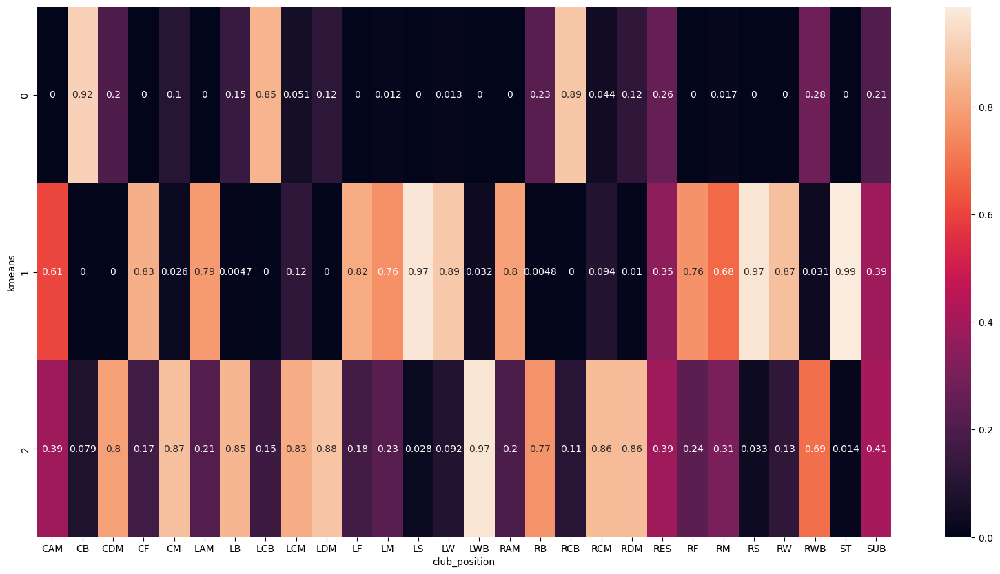

In [136]:
#Heatmap club position
plt.figure(figsize=(20,10))
sns.heatmap(pd.crosstab(df_clusters_sa.kmeans, df_clusters_sa.club_position, normalize='columns'),annot=True)
plt.show()


Se puede observar una no tan clara dependencia de posiciones y clusters. Existen posiciones en donde el 99% de los jugadores pertenecen a un determinado cluster, mientras que también existen otras con valores intermedios. 

<Figure size 2000x1000 with 0 Axes>

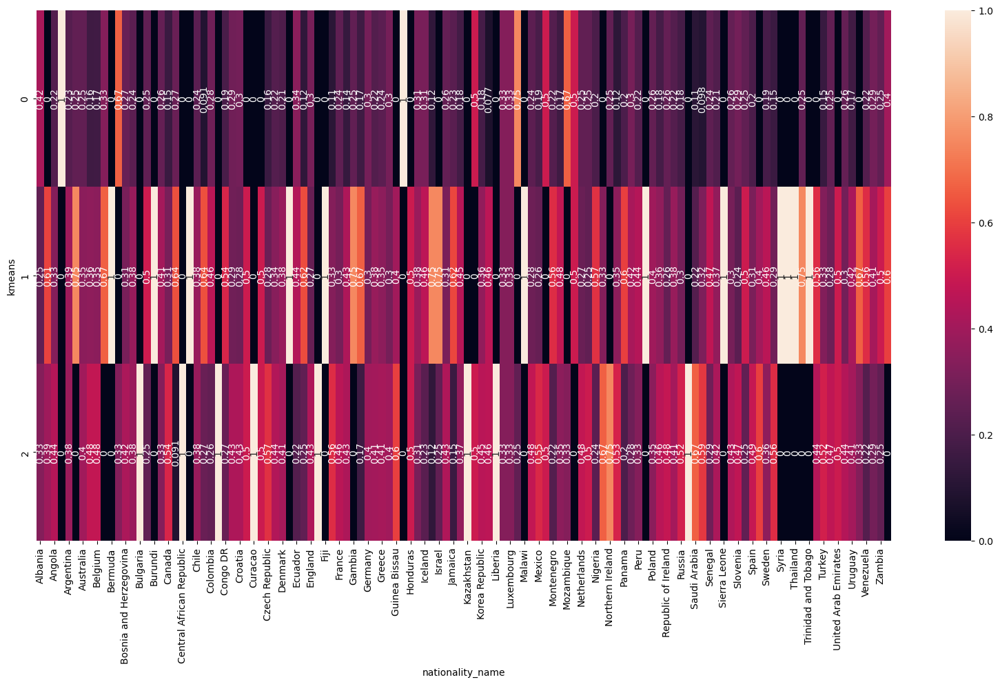

In [138]:
#Heatmap nacionalidad
plt.figure(figsize=(20,10))
sns.heatmap(pd.crosstab(df_clusters_sa.kmeans, df_clusters_sa.nationality_name, normalize="columns"),annot=True,annot_kws={'rotation':90})
plt.show()

En el gráfico anterior, podemos observar que solamente para ciertos paises existe correlacion con los clusters. Existen otros países que contribuyen con jugadores a los 3 clusters de manera similar. 

Automatically created module for IPython interactive environment
Para n_clusters = 2 El silhouette_score promedio es : 0.27854729591078364
Para n_clusters = 3 El silhouette_score promedio es : 0.265199196069597
Para n_clusters = 4 El silhouette_score promedio es : 0.22779562699529723
Para n_clusters = 5 El silhouette_score promedio es : 0.18505383100393225
Para n_clusters = 6 El silhouette_score promedio es : 0.17351882785061923


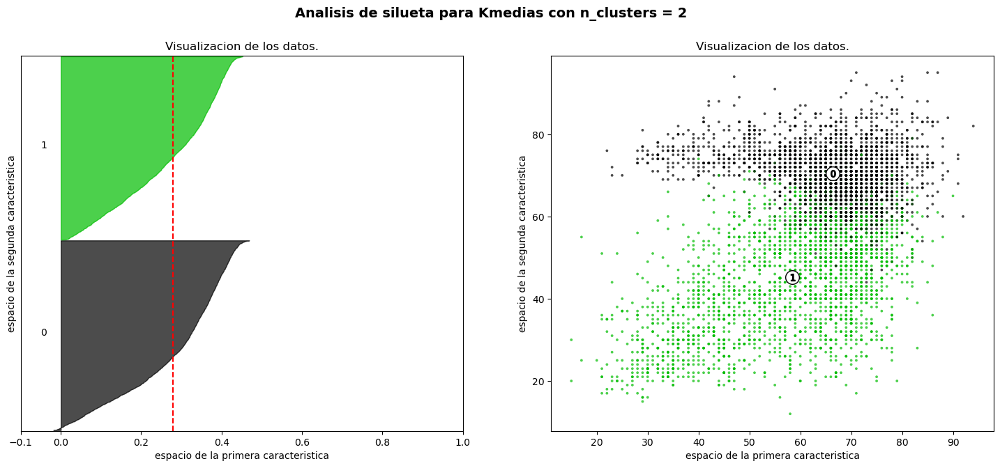

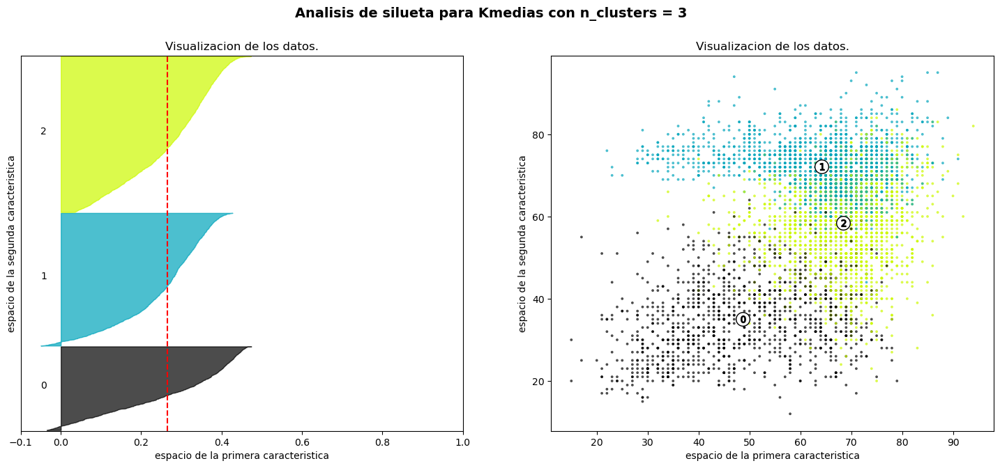

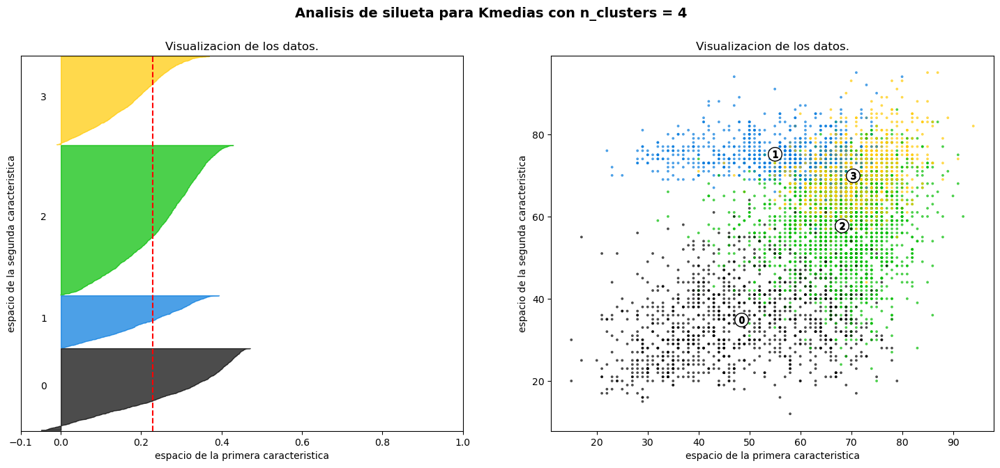

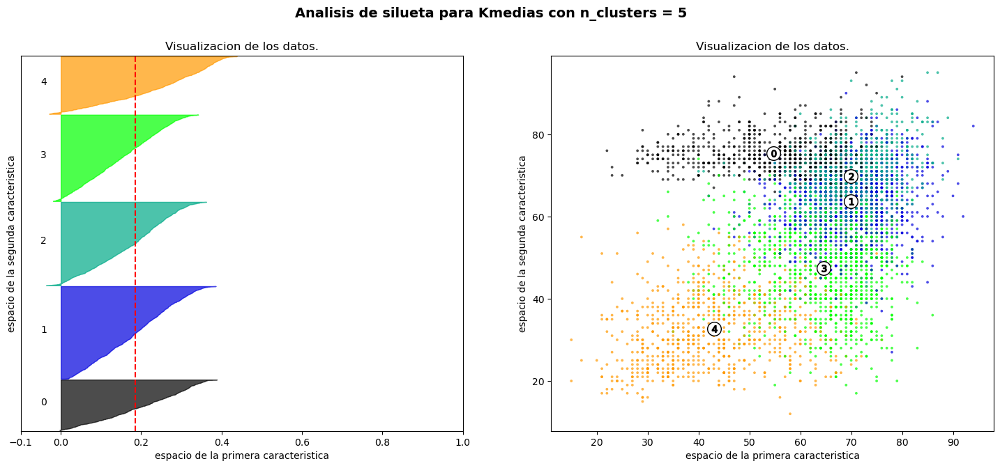

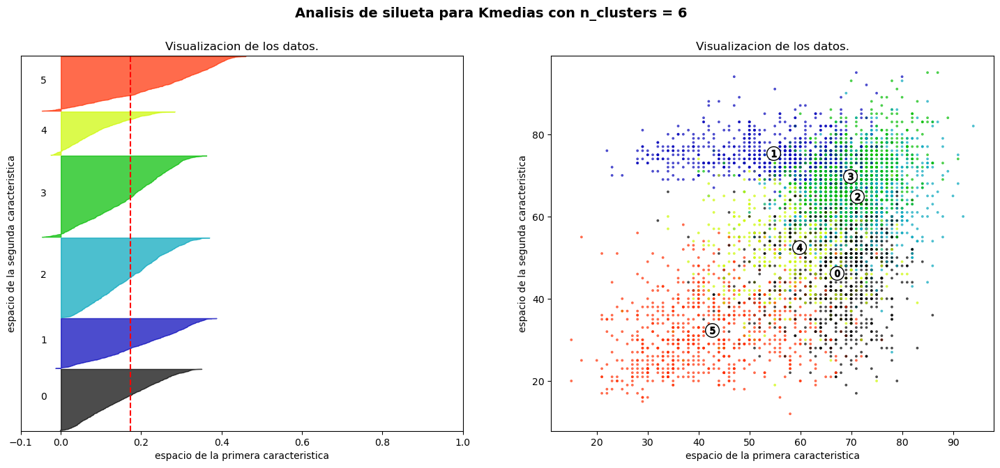

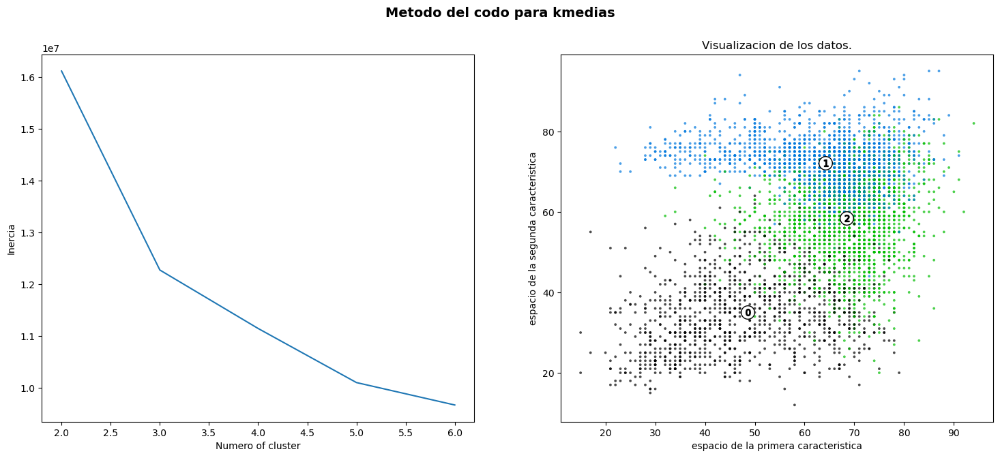

In [139]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)

X=df_skills

range_n_clusters = [2,3, 4, 5, 6]
sse ={}
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)
    sse[n_clusters] = clusterer.inertia_

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("Para n_clusters =", n_clusters,
          "El silhouette_score promedio es :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Visualizacion de los datos.")
    ax1.set_xlabel("espacio de la primera caracteristica")
    ax1.set_ylabel("espacio de la segunda caracteristica")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])


    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X.iloc[:, 0], X.iloc[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("Visualizacion de los datos.")
    ax2.set_xlabel("espacio de la primera caracteristica")
    ax2.set_ylabel("espacio de la segunda caracteristica")

    plt.suptitle(("Analisis de silueta para Kmedias "
                  "con n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    #plt.savefig("kmeans_%d" % n_clusters, dpi=300)

plt.show()

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(18, 7)
plt.suptitle(("Metodo del codo para kmedias "),
                 fontsize=14, fontweight='bold')
ax1.plot(list(sse.keys()), list(sse.values()))
ax1.set_xlabel("Numero of cluster")
ax1.set_ylabel("Inercia")

clusterer = KMeans(n_clusters=3, random_state=10)
cluster_labels = clusterer.fit_predict(X)
    
colors = cm.nipy_spectral(cluster_labels.astype(float) / 4)
ax2.scatter(X.iloc[:, 0], X.iloc[:, 1], marker='.', s=30, lw=0, alpha=0.7,c=colors, edgecolor='k')

# Labeling the clusters
centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
ax2.scatter(centers[:, 0], centers[:, 1], marker='o',c="white", alpha=1, s=200, edgecolor='k')

for i, c in enumerate(centers):
    ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,s=50, edgecolor='k')

ax2.set_title("Visualizacion de los datos.")
ax2.set_xlabel("espacio de la primera caracteristica")
ax2.set_ylabel("espacio de la segunda caracteristica")

#plt.savefig("kmeans_elbow", dpi=300)
plt.show()

Al evaluar kmeans con el dataset sin arqueros se obtuvieron un agrupamiento de clsuters principalmente asociado a la posición de los jugadores, como se mencionó anteriormente. Además, se vio que algunas nacionalidades también podrían diferenciar lo mismo, como así también el salario, peso y altura. 


# Embedding

## TSNE

In [172]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns',100)
pd.set_option('display.max_rows',1000)
import itertools
import warnings
warnings.filterwarnings("ignore")
import io

from sklearn import (manifold, preprocessing, decomposition)
import time

from plotly.offline import init_notebook_mode, plot,iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import plotly.tools as tls#visualization
import plotly.figure_factory as ff#visualization
import seaborn as sns

from sklearn.cluster import KMeans,MeanShift
from sklearn import decomposition
from sklearn import metrics

In [169]:
n_sne=2000 #elegir numero pequeño para agilidad en el cálculo luego
df_sne=df.loc[:n_sne]
skills_ratings = ['attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy', 'attacking_short_passing',
                  'attacking_volleys', 'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
                  'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_reactions',
                  'movement_balance', 'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
                  'mentality_aggression', 'mentality_interceptions', 'mentality_positioning', 'mentality_vision', 'mentality_penalties', 
                  'mentality_composure', 'defending_standing_tackle', 'defending_sliding_tackle',
                  'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning', 'goalkeeping_reflexes']
X=df_sne[skills_ratings]
print('dimensión del espacio de los datos: ', len(skills_ratings))

dimensión del espacio de los datos:  33


In [170]:
X.head(5)

,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes
0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,35,24,6,11,15,14,8
1,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,42,19,15,6,12,8,10
2,87,95,90,80,86,88,81,84,77,88,85,88,86,94,74,94,95,77,77,93,63,29,95,76,88,95,32,24,7,11,15,14,11
3,85,83,63,86,86,95,88,87,81,95,93,89,96,89,84,80,64,81,53,81,63,37,86,90,93,93,32,29,9,9,15,15,11
4,94,82,55,94,82,88,85,83,93,91,76,76,79,91,78,91,63,89,74,91,76,66,88,94,83,89,65,53,15,13,5,10,13


In [173]:
#Transformamos el espacio de dim 33 en un espacio de dimensión 2 (n_components=2)

time_start = time.time()

tsne = manifold.TSNE(n_components=2, verbose=1,perplexity=30, n_iter=1000)
X_tsne = tsne.fit_transform(X)

print ('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2001 samples in 0.000s...
[t-SNE] Computed neighbors for 2001 samples in 0.117s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2001
[t-SNE] Computed conditional probabilities for sample 2000 / 2001
[t-SNE] Computed conditional probabilities for sample 2001 / 2001
[t-SNE] Mean sigma: 15.788894
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.594360
[t-SNE] KL divergence after 1000 iterations: 1.336268
t-SNE done! Time elapsed: 14.171709299087524 seconds


In [174]:
X_tsne[1990:2000] #diez jugadores

array([[-11.875294 ,  46.794678 ],
       [ 48.4104   , -18.244331 ],
       [-41.73427  , -27.386396 ],
       [  9.541419 , -33.66124  ],
       [  4.4292893,   2.1611145],
       [-10.773927 ,  51.33026  ],
       [ 11.39372  ,  15.64033  ],
       [-17.16037  ,  42.506447 ],
       [ 10.979594 ,   8.105729 ],
       [ 18.659586 , -25.905224 ]], dtype=float32)

In [177]:
data=[]
bool_crack=df_sne["overall"] > 85 #diferenciamos a los mejores jugadores

#graficamos los datos en el espacio transformado: las dos componentes tsne

graf1 = go.Scatter(x=X_tsne[:,0], y=X_tsne[:,1],
                           mode='markers',
                        text=df_sne.loc[:,'club_position'], #'Height', 'Weight', 'Club', 'Age', 'Name','Position'
                           marker=dict(
                                size=5)
                           )

crack =go.Scatter(x=X_tsne[bool_crack,0], y=X_tsne[bool_crack,1],name='Los más mejores',
                      text=df_sne.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[graf1,crack]

layout = go.Layout(title="Visualización de la base en el espacio tsne",titlefont=dict(size=20),
                xaxis=dict(title='componente 1'),
                yaxis=dict(title='componente 2'),
                autosize=False, width=1000,height=700)

fig = go.Figure(data=data, layout=layout)

#iplot(fig)
plot(fig)

'temp-plot.html'

In [178]:
forwards=['RF', 'ST', 'LW', 'LF', 'RS', 'LS', 'RM', 'LM','RW']
midfielders=['RCM','LCM','LDM','CAM','CDM','LAM','RDM','CM','RAM','CF']
defenders=['RCB','CB','LCB','LB','RB','RWB','LWB']
goalkeepers=['GK']

def pos2(position):
    if position in forwards:
        return 'Forward'
    
    elif position in midfielders:
        return 'Midfielder'
    
    elif position in defenders:
        return 'Defender'
    
    elif position in goalkeepers:
        return 'GK'
    
    else:
        return 'nan'

In [180]:
df_sne["team_position2"]=df_sne["club_position"].apply(lambda x: pos2(x))

df_sne["team_position2"].value_counts()

nan           683
Forward       402
Defender      395
Midfielder    373
GK            148
Name: team_position2, dtype: int64

In [181]:
df_sne.head()

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,dob,height_cm,weight_kg,club_team_id,club_name,league_name,league_level,club_position,club_jersey_number,club_loaned_from,club_joined,club_contract_valid_until,nationality_id,nationality_name,nation_team_id,nation_position,nation_jersey_number,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,real_face,release_clause_eur,player_tags,player_traits,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,...,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,team_position2
0,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,"RW, ST, CF",93,93,78000000.0,320000.0,34,1987-06-24,170,72,73.0,Paris Saint-Germain,French Ligue 1,1.0,RW,30.0,NaN,2021-08-10,2023.0,52,Argentina,1369.0,RW,10.0,Left,4,4,5,Medium/Low,Unique,Yes,144300000.0,"#Dribbler, #Distance Shooter, #FK Specialist, ...","Finesse Shot, Long Shot Taker (AI), Playmaker ...",85.0,92.0,91.0,95.0,34.0,65.0,85,95,70,91,88,96,93,...,69,94,44,40,93,95,75,96,20,35,24,6,11,15,14,8,NaN,89+3,89+3,89+3,92,93,93,93,92,93,93,93,91+2,87+3,87+3,87+3,91+2,66+3,64+3,64+3,64+3,66+3,61+3,50+3,50+3,50+3,61+3,19+3,https://cdn.sofifa.net/players/158/023/22_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,Forward
1,188545,https://sofifa.com/player/188545/robert-lewand...,R. Lewandowski,Robert Lewandowski,ST,92,92,119500000.0,270000.0,32,1988-08-21,185,81,21.0,FC Bayern München,German 1. Bundesliga,1.0,ST,9.0,NaN,2014-07-01,2023.0,37,Poland,1353.0,RS,9.0,Right,4,4,5,High/Medium,Unique,Yes,197200000.0,"#Aerial Threat, #Distance Shooter, #Clinical F...","Solid Player, Finesse Shot, Outside Foot Shot,...",78.0,92.0,79.0,86.0,44.0,82.0,71,95,90,85,89,85,79,...,86,87,81,49,95,81,90,88,35,42,19,15,6,12,8,10,NaN,90+2,90+2,90+2,85,88,88,88,85,86+3,86+3,86+3,84+3,80+3,80+3,80+3,84+3,64+3,66+3,66+3,66+3,64+3,61+3,60+3,60+3,60+3,61+3,19+3,https://cdn.sofifa.net/players/188/545/22_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1353/60.png,https://cdn.sofifa.net/flags/pl.png,Forward
2,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"ST, LW",91,91,45000000.0,270000.0,36,1985-02-05,187,83,11.0,Manchester United,English Premier League,1.0,ST,7.0,NaN,2021-08-27,2023.0,38,Portugal,1354.0,ST,7.0,Right,4,5,5,High/Low,Unique,Yes,83300000.0,"#Aerial Threat, #Dribbler, #Distance Shooter, ...","Power Free-Kick, Flair, Long Shot Taker (AI), ...",87.0,94.0,80.0,88.0,34.0,75.0,87,95,90,80,86,88,81,...,77,93,63,29,95,76,88,95,24,32,24,7,11,15,14,11,NaN,90+1,90+1,90+1,88,89,89,89,88,86+3,86+3,86+3,86+3,78+3,78+3,78+3,86+3,63+3,59+3,59+3,59+3,63+3,60+3,53+3,53+3,53+3,60+3,20+3,https://cdn.sofifa.net/players/020/801/22_120.png,https://cdn.sofifa.net/teams/11/60.png,https://cdn.sofifa.net/flags/gb-eng.png,https://cdn.sofifa.net/teams/1354/60.png,https://cdn.sofifa.net/flags/pt.png,Forward
3,190871,https://sofifa.com/player/190871/neymar-da-sil...,Neymar Jr,Neymar da Silva Santos Júnior,"LW, CAM",91,91,129000000.0,270000.0,29,1992-02-05,175,68,73.0,Paris Saint-Germain,French Ligue 1,1.0,LW,10.0,NaN,2017-08-03,2025.0,54,Brazil,N

In [182]:
bool_striker= df_sne["team_position2"] == 'Forward'
bool_midfielder= df_sne["team_position2"] == 'Midfielder'
bool_defender= df_sne["team_position2"] == 'Defender'
bool_gk= df_sne["team_position2"] == 'GK'

bool_crack=df_sne["overall"] > 85

palette=['navy','red','#A2D5F2','orange','green','pink']  
data=[]

striker =go.Scatter(x=X_tsne[bool_striker,0], y=X_tsne[bool_striker,1],name='Striker',
                      text=df_sne.loc[bool_striker,'short_name'],
                      opacity=0.9,marker=dict(color=palette[2],size=5),mode='markers')

midfielder =go.Scatter(x=X_tsne[bool_midfielder,0], y=X_tsne[bool_midfielder,1],name='Midfielder',
                      text=df_sne.loc[bool_midfielder,'short_name'],
                      opacity=0.6,marker=dict(color=palette[1],size=5),mode='markers')

defender =go.Scatter(x=X_tsne[bool_defender,0], y=X_tsne[bool_defender,1],name='Defender',
                      text=df_sne.loc[bool_defender,'short_name'],
                      opacity=0.7,marker=dict(color=palette[3],size=5),mode='markers')

gk =go.Scatter(x=X_tsne[bool_gk,0], y=X_tsne[bool_gk,1],name='GK',
                      text=df_sne.loc[bool_gk,'short_name'],
                      opacity=0.4,marker=dict(color=palette[4],size=5),mode='markers')

crack =go.Scatter(x=X_tsne[bool_crack,0], y=X_tsne[bool_crack,1],name='Top player',
                      text=df_sne.loc[bool_crack,'short_name'],textfont=dict(family='sans serif',color='black',size=16),
                      opacity=0.9,mode='text')

data=[striker,midfielder,defender,gk,crack]

layout = go.Layout(title="t-SNE - Fifa Players",titlefont=dict(size=20),
                autosize=False, width=1150,height=750)

fig = go.Figure(data=data, layout=layout)

#iplot(fig)
plot(fig)

'temp-plot.html'

Con la figura anterior, podemos ver que t-SNE está segregando a los grupos relativamente bien a pesar de haber una pequeña superposición entre ellos. Otra vez, los arqueros se encuentran ubicados en un espacio totalmente alejado del resto de las posiciones debido a sus distintivas caracteristicas. Por otro lado, observamos esta superposición entre las demás posiciones ya que tSNE no las separó perfectamente. Quizás esto podría ser mejorado agregando más variables al dataset o utilizando otro algoritmo de embedding que, por ejemplo, tenga en cuenta la estructura global (ademas de la local) de los datos.

#### Analisis descriptivo por posicion

In [184]:
df_sne.groupby("team_position2").mean()

,sofifa_id,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,club_team_id,league_level,club_jersey_number,club_contract_valid_until,nationality_id,nation_team_id,nation_jersey_number,weak_foot,skill_moves,international_reputation,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed
team_position2,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Defender,213553.559494,78.005063,79.972152,1.638329e+07,42535.063291,27.648101,183.301266,78.000000,15518.255696,1.037975,14.210127,2023.498734,42.782278,10078.297619,9.226190,2.982278,2.508861,1.673418,3.131276e+07,70.232911,50.850633,65.458228,67.837975,76.703797,76.177215,62.083544,45.759494,72.473418,73.164557,44.073418,65.339241,55.486076,47.091139,68.405063,71.179747,68.427848,71.708861,64.850633,75.443038,62.918987,63.837975,74.934177,75.402532,76.420253,50.460759,76.693671,76.691139,54.425316,60.032911,49.205063,72.830380,76.637975,78.017722,76.491139,10.640506,10.367089,10.602532,10.313924,10.610127,NaN
Forward,211131.151741,78.445274,80.323383,2.094888e+07,47355.597015,27.783582,179.634328,74.487562,23275.047264,1.037313,16.848259,2023.315920,49.840796,7535.058140,12.906977,3.509950,3.544776,1.820896,4.020315e+07,78.216418,75.599502,71.398010,78.395522,42.898010,69.199005,69.368159,76.296020,64.300995,74.940299,71.116915,78.860697,71.674129,63.164179,65.955224,79.104478,78.549751,77.947761,78.094527,76.783582,74.176617,77.975124,69.206468,74.278607,68.915423,73.442786,63.415423,40.803483,78.022388,73.211443,69.681592,76.097015,41.838308,40.472637,35.853234,10.258706,10.587065,10.738806,10.599502,10.522388,NaN
GK,197558.763514,78.918919,80.331081,1.439155e+07,33993.918919,30.047297,189.986486,84.054054,20351.148649,1.060811,11.358108,2023.391892,42.175676,8597.395349,9.906977,2.716216,1.000000,1.709459,2.830734e+07,NaN,NaN,NaN,NaN,NaN,NaN,14.837838,12.898649,14.871622,33.675676,13.750000,16.452703,16.513514,15.074324,32.222973,24.114865,45.256757,45.750000,48.236486,74.662162,44.155405,54.763514,65.885135,35.885135,68.351351,14.317568,30.337838,20.310811,12.905405,50.202703,22.817568,56.108108,17.608108,14.885135,14.641892,78.993243,76.148649,72.844595,78.371622,80.641892,45.432432
Midfielder,210719.962466,78.171582,80.080429,1.887145e+07,44536.327078,27.812332,179.482574,73.790885,22219.265416,1.034853,16.190349,2023.359249,45.517426,11908.400000,13.311111,3.383378,3.227882,1.737265,3.591409e+07,67.967828,68.680965,75.029491,76.675603,66.340483,72.353887,68.640751,65.769437,60.785523,79.504021,62.088472,76.227882,69.847185,65.211796,76.372654,78.890080,68.959786,67.155496,73.605898,76.506702,73.493298,74.871314,67.040214,79.474531,69.627346,71.289544,71.485255,68.340483,70.710456,76.214477,64.005362,76.592493,66.112601,67.793566,63.211796,10.554960,10.514745,10.458445,10.522788,10.249330,NaN
nan,211566.844802,77.288433,79.563690,1.424022e+07,46854.754829,27.450952,181.988287,76.409956,12200.046062,1.025260,19.080238,2023.432392,47.689605,8776.852174,12.269565,3.226940,2.983895,1.689605,2.761010e+07,71.788122,64.728732,69.956661,74.409310,60.256822,71.304976,62.120059,57.833089,60.644217,71.594436,55.439239,68.884334,61.733529,52.655930,65.370425,71.680820,69.559297,69.655930,70.074671,74.959004,67.963397,70.692533,69.534407,70.522694,70.159590,60.128843,66.37481

#### Kmeans sobre tSNE

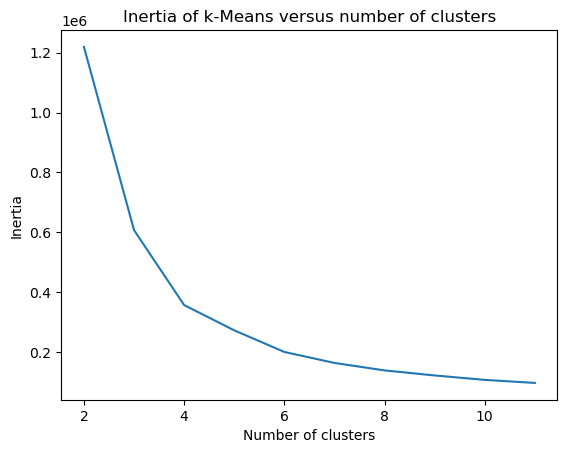

In [187]:
#Cantidad de n_clusters a elegir en el método de K-medias, variando de 2 a 11 clusters
scores = [KMeans(n_clusters=i).fit(X_tsne).inertia_ for i in range(2,12)]

plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")
plt.show()


El numero apto de clusters pareciera ser 4. 

Automatically created module for IPython interactive environment
Para n_clusters = 2 El silhouette_score promedio es : 0.49642658
Para n_clusters = 3 El silhouette_score promedio es : 0.5957495
Para n_clusters = 4 El silhouette_score promedio es : 0.5310286
Para n_clusters = 5 El silhouette_score promedio es : 0.48254663
Para n_clusters = 6 El silhouette_score promedio es : 0.4633911


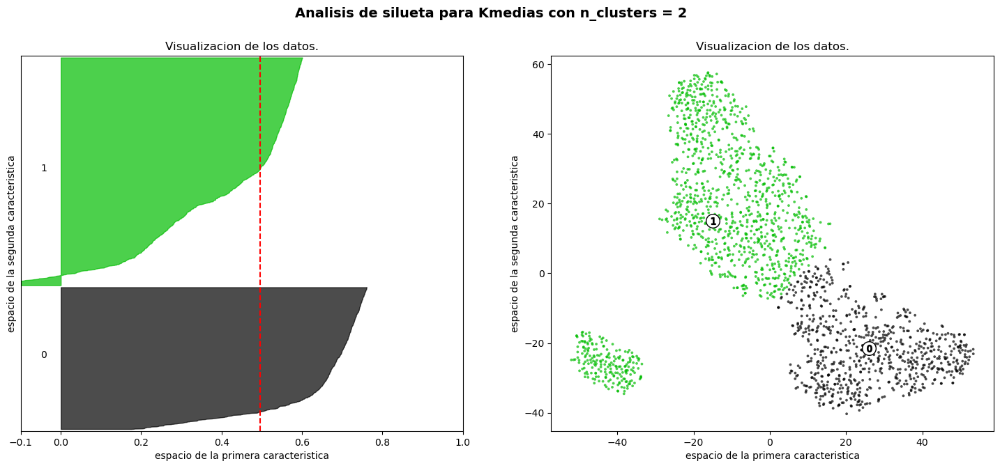

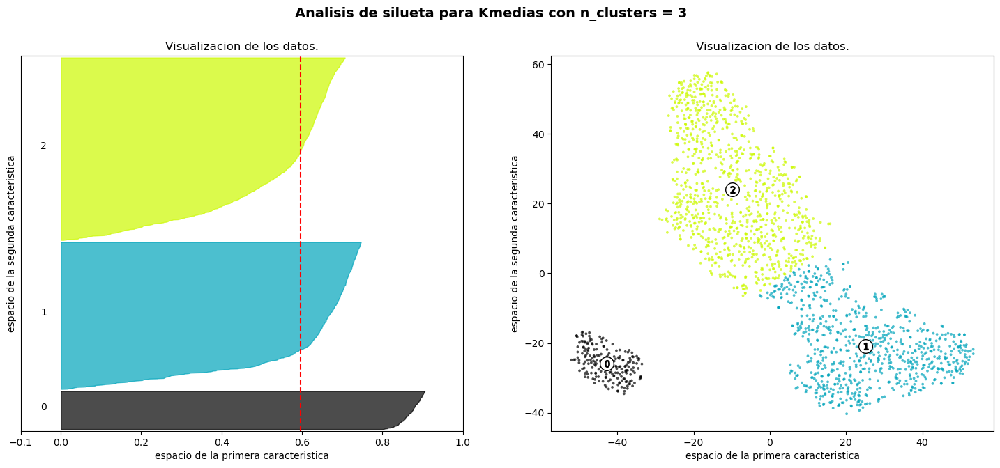

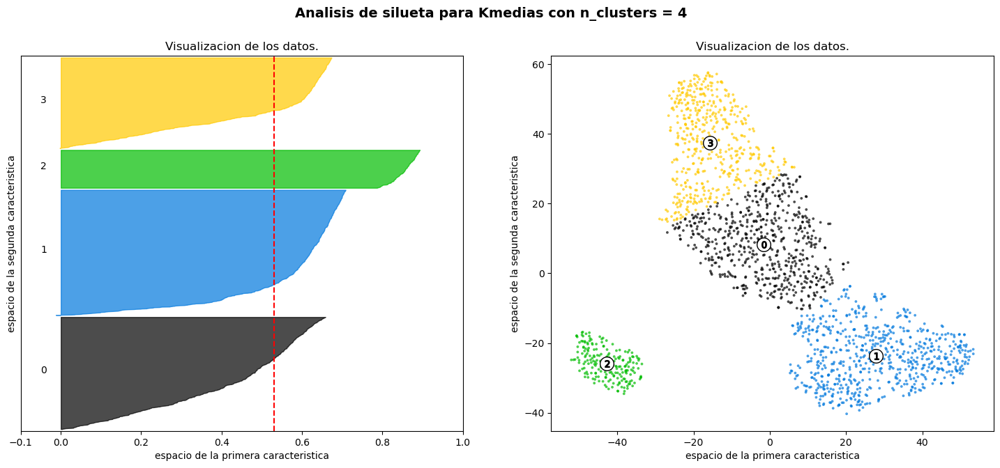

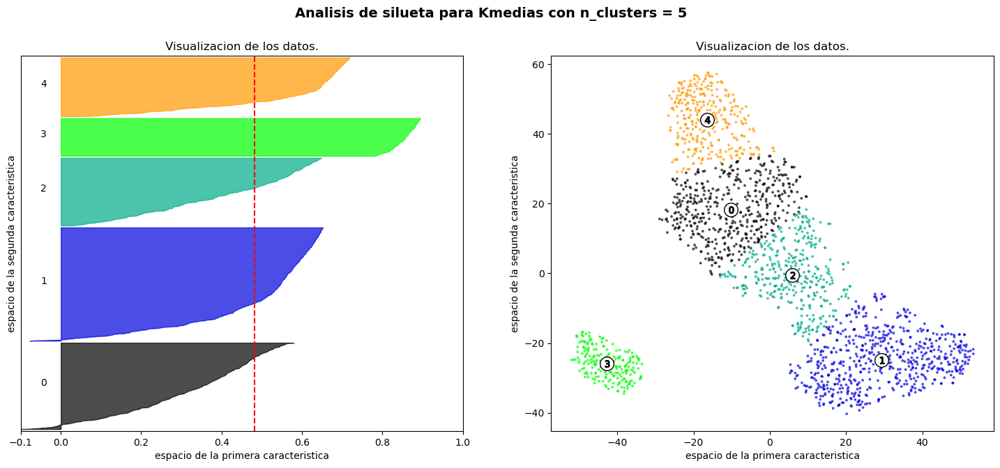

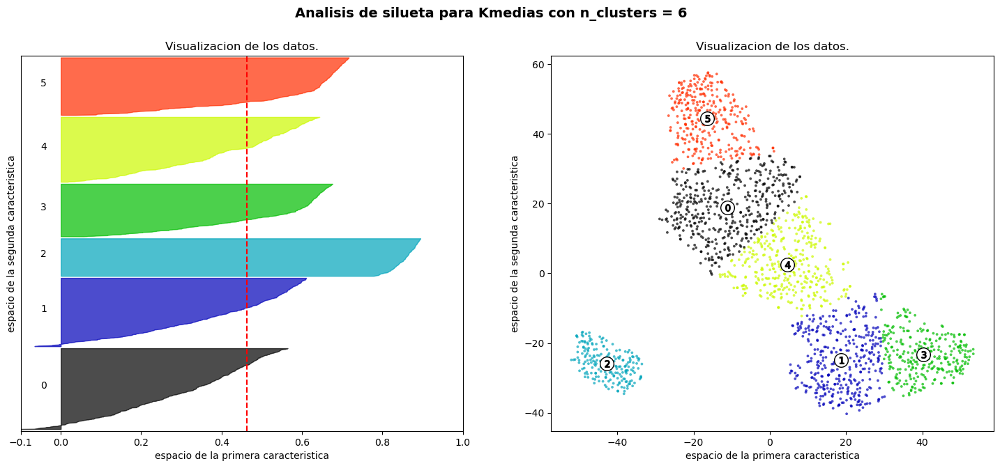

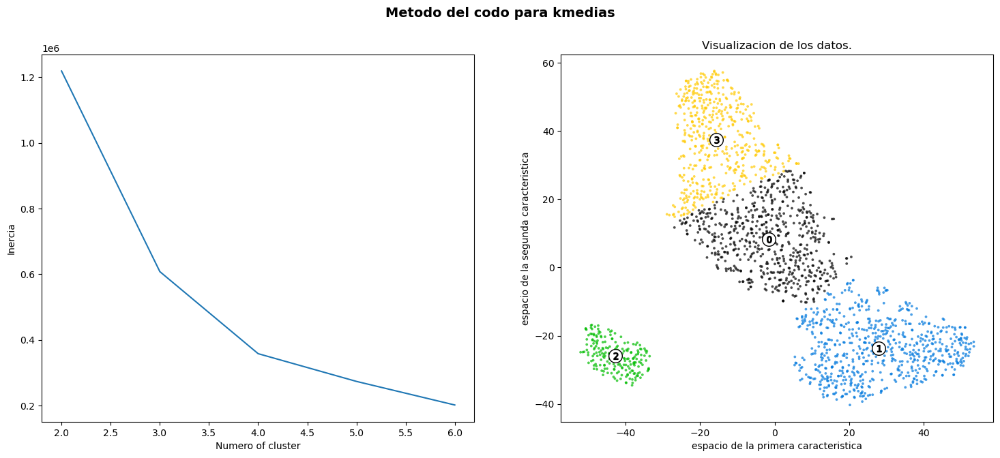

In [188]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)

X=X_tsne

range_n_clusters = [2,3, 4, 5, 6]
sse ={}
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)
    sse[n_clusters] = clusterer.inertia_

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("Para n_clusters =", n_clusters,
          "El silhouette_score promedio es :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Visualizacion de los datos.")
    ax1.set_xlabel("espacio de la primera caracteristica")
    ax1.set_ylabel("espacio de la segunda caracteristica")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])


    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("Visualizacion de los datos.")
    ax2.set_xlabel("espacio de la primera caracteristica")
    ax2.set_ylabel("espacio de la segunda caracteristica")

    plt.suptitle(("Analisis de silueta para Kmedias "
                  "con n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    #plt.savefig("kmeans_%d" % n_clusters, dpi=300)

plt.show()

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(18, 7)
plt.suptitle(("Metodo del codo para kmedias "),
                 fontsize=14, fontweight='bold')
ax1.plot(list(sse.keys()), list(sse.values()))
ax1.set_xlabel("Numero of cluster")
ax1.set_ylabel("Inercia")

clusterer = KMeans(n_clusters=4, random_state=10)
cluster_labels = clusterer.fit_predict(X)
    
colors = cm.nipy_spectral(cluster_labels.astype(float) / 4)
ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,c=colors, edgecolor='k')

# Labeling the clusters
centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
ax2.scatter(centers[:, 0], centers[:, 1], marker='o',c="white", alpha=1, s=200, edgecolor='k')

for i, c in enumerate(centers):
    ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,s=50, edgecolor='k')

ax2.set_title("Visualizacion de los datos.")
ax2.set_xlabel("espacio de la primera caracteristica")
ax2.set_ylabel("espacio de la segunda caracteristica")

#plt.savefig("kmeans_elbow", dpi=300)
plt.show()


El número óptimo de clusters podría ser 3 o 4, hay un mayor quiebre del brazo en el 4 pero el 3 tiene mayor coeficiente de silueta. Tomamos el valor de 4 clusters para lo que acá continúa.

In [189]:
n_clust = 4 ##Número óptimo de clusters

km = KMeans(n_clusters=n_clust)
km.fit(X_tsne) #utiliza todas las habilidades: 34 dimensiones

# Recuperacion de etiquetas
clusters = km.labels_
print('Suma de los cuadrados de las distancias al cluster=Inertia= ', km.inertia_)

Suma de los cuadrados de las distancias al cluster=Inertia=  357928.65625


In [191]:
data=[]
bool_crack=df_sne["overall"] > 85 #diferenciamos a los mejores jugadores

#graficamos los datos en el espacio transformado: las dos componentes tsne

graf1 = go.Scatter(x=X_tsne[:,0], y=X_tsne[:,1],
                           mode='markers',
                        text=df_sne.loc[:,'club_position'], #'Height', 'Weight', 'Club', 'Age', 'Name','Position'
                           marker=dict(
                                size=5,
                           color = clusters.astype(np.float))
                           )

crack =go.Scatter(x=X_tsne[bool_crack,0], y=X_tsne[bool_crack,1],name='Los más mejores',
                      text=df_sne.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[graf1,crack]

layout = go.Layout(title="Visualización de la base en el espacio tsne",titlefont=dict(size=20),
                xaxis=dict(title='componente 1'),
                yaxis=dict(title='componente 2'),
                autosize=False, width=1000,height=700)

fig = go.Figure(data=data, layout=layout)

#iplot(fig)
plot(fig)

'temp-plot.html'

Se observa la división entre las posiciones ahora es más clara que en el inciso anterior, lo que permite una mejor diferenciacion entre cada clase.

#### Meanshift 

In [192]:
#Exploramos el número de clusters que se encuentran por medio del Método de MeanShift
#ms = MeanShift(bandwidth=14, bin_seeding=True)   #A medida que agrandamos el bandwidth, se va reduciendo la cantidad de clusters encontrados.
ms = MeanShift( bin_seeding=True)

ms.fit(X_tsne)

clusters2 = ms.labels_
cluster_centers = ms.cluster_centers_

labels_unique = np.unique(clusters2)
n_clusters_ = len(labels_unique)

print("Cantidad de clusters encontrados por Mean Shift : %d" % n_clusters_)
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X_tsne, clusters2))

Cantidad de clusters encontrados por Mean Shift : 3
Silhouette Coefficient: 0.595


In [196]:
data=[]
bool_crack=df_sne["overall"] > 85 #diferenciamos a los mejores jugadores

#graficamos los datos en el espacio transformado: las dos componentes tsne

graf1 = go.Scatter(x=X_tsne[:,0], y=X_tsne[:,1],
                           mode='markers',
                        text=df_sne.loc[:,'club_position'], #'Height', 'Weight', 'Club', 'Age', 'Name','Position'
                           marker=dict(
                                size=5,
                           color = clusters2.astype(np.float))
                           )

crack =go.Scatter(x=X_tsne[bool_crack,0], y=X_tsne[bool_crack,1],name='Los más mejores',
                      text=df_sne.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[graf1,crack]

layout = go.Layout(title="Visualización de la base en el espacio tsne",titlefont=dict(size=20),
                xaxis=dict(title='componente 1'),
                yaxis=dict(title='componente 2'),
                autosize=False, width=1000,height=700)

fig = go.Figure(data=data, layout=layout)

#iplot(fig)
plot(fig)

'temp-plot.html'

Se observa una buena distinción entre los 3 clusters encontrados por meanshift. Cabe aclarar que dejando los parámetros por defecto y excluyendo a tSNE, meanshift encontraba solamente 1 cluster.

# PCA

In [199]:

#Retiramos arqueros y jugadores con bajo ranking**


n_acp=18000

df_acp=df.loc[:n_acp]
df_acp=df_acp[(df_acp["club_position"]!='GK')&(df['overall']>70)]

skills_ratings = ['attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy', 'attacking_short_passing',
                  'attacking_volleys', 'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
                  'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_reactions',
                  'movement_balance', 'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots',
                  'mentality_aggression', 'mentality_interceptions', 'mentality_positioning', 'mentality_vision', 'mentality_penalties', 
                  'mentality_composure', 'defending_standing_tackle', 'defending_sliding_tackle'] 

#otros skills_ratings ! sacamos las habilidades de los arqueros

In [200]:
#Restringimos los datos a las variables numéricas que consideramos

X=df_acp[skills_ratings] # Datos para proyectar
print('los datos tienen dimesión n= ',len(skills_ratings))

los datos tienen dimesión n=  28


In [201]:
#Estandarizamos
#Restringimos los datos a las variables numéricas que consideramos

X=df_acp[skills_ratings] # Datos para proyectar
print('los datos tienen dimesión n= ',len(skills_ratings))

std_scale=preprocessing.StandardScaler().fit(X)
X_scaled=std_scale.transform(X) # numpyarray Estandarizado (le resta la media y divide por el desvío) por columna

print(X_scaled[0:2])
X.head(2)

los datos tienen dimesión n=  28
[[ 1.48048674  2.06474223  0.54675286  2.02773674  1.97396264  1.94594615
   1.93186041  2.35052388  2.24880563  2.15355872  1.5891453   0.7738017
   1.61238835  3.96544969  2.00147893  1.52772151 -0.10678475 -0.02052369
  -0.10687145  1.97612817 -1.51566385 -0.82921173  1.76423747  2.43502122
   1.22399967  3.2395227  -1.05842517 -1.40004801]
 [ 0.60122673  2.06474223  1.88485813  1.43105293  2.03187365  1.18184746
   1.10858774  1.83364491  0.44724743  1.46880793  0.54881999  0.69768339
   0.55246278  3.78591251  1.04259464  1.87776256  1.28990563  0.30386362
   1.35739139  1.57310106  0.98007051 -0.38919566  1.87944501  1.31360589
   2.23936304  2.23178558 -0.72784959 -1.63145691]]


,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_standing_tackle,defending_sliding_tackle
0,85,95,70,91,88,96,93,94,91,96,91,80,91,94,95,86,68,72,69,94,44,40,93,95,75,96,35,24
1,71,95,90,85,89,85,79,85,70,88,77,79,77,93,82,90,85,76,86,87,81,49,95,81,90,88,42,19


In [202]:
#PCA

pca=decomposition.PCA(n_components=4) #elegimos 2, 3 o 4 pero pueden ser más.
#En función de la varianza explicada, creo que con 3 es más que suficiente

pca.fit(X_scaled) #input data is centered but not scaled for each feature before applying the SVD

# proporción de varianza
print('proporción de varianza por componente: ', pca.explained_variance_ratio_)
# proporción de varianza acumulada
print ('proporción de varianza por componente acumulada: ', pca.explained_variance_ratio_.cumsum())

X_projected=pca.transform(X_scaled) #numpy array
print ('tamaño de los datos: ', X_projected.shape)


proporción de varianza por componente:  [0.43777383 0.1837487  0.09117712 0.06574892]
proporción de varianza por componente acumulada:  [0.43777383 0.62152253 0.71269965 0.77844856]
tamaño de los datos:  (4307, 4)


In [203]:
print (X_projected[0:5])#5 primeros jugadores, n_components

[[-8.52338709  1.32201849  1.47630761  0.74677732]
 [-6.38468781 -0.20270862  3.85561049 -1.61722778]
 [-7.11313812  0.64963768  3.31344449 -2.19367885]
 [-7.78654253  1.52360323  0.42254161  0.21786378]
 [-7.34935459 -1.46696441  1.4719432   1.64688306]]


In [205]:
pcs=pca.components_  #"composición" de las primeras componentes, 
print(pcs)  # el aporte/pesos de las variables: skills_ratings

[[-0.23639446 -0.24276263 -0.04903053 -0.22836492 -0.23875713 -0.26705048
  -0.25380729 -0.22462336 -0.18239532 -0.25825774 -0.1783608  -0.15361028
  -0.21157253 -0.10276324 -0.19242332 -0.19926924  0.02377693 -0.15775953
   0.07653274 -0.25401893 -0.04314977  0.0059905  -0.25838014 -0.23138394
  -0.21751179 -0.18519277  0.00614806  0.01800779]
 [-0.0508707   0.12364484 -0.26514329 -0.19762613  0.09782157 -0.02033442
   0.01688091  0.02376116 -0.2289408  -0.10271005  0.09248951  0.05391255
   0.1091695  -0.08895461  0.07527937  0.07029527 -0.14824835 -0.20902059
  -0.21044171  0.04762632 -0.35648386 -0.40398595  0.05889967  0.04569318
   0.06872996 -0.12232573 -0.40838277 -0.40316755]
 [-0.15963953  0.17252442  0.2753954   0.00049833  0.20123472 -0.05200932
  -0.00662338  0.05006522 -0.05573411  0.00977069 -0.32797215 -0.28027251
  -0.29558051  0.17728579 -0.32135158  0.26001364  0.05881551 -0.13606546
   0.3628084   0.13490437  0.08941605 -0.14526612  0.08360674  0.02691459
   0.22913

In [206]:
#El siguiente gráfico muestra la composición de los pesos de las dos primeras componentes principales. 

#Graph 1
data=[]

for i, (x,y) in enumerate(zip(pcs[0,:],pcs[1,:])):
    graph=go.Scatter(x=[0,x],y=[0,y],text=X.columns[i],
                     mode='lines+markers+text',textposition='top left',textfont=dict(family='sans serif',size=15))
    data.append(graph)

layout = go.Layout(title="ACP - Fifa Skills",titlefont=dict(size=20),
            xaxis=dict(title='Componente 1'),
            yaxis=dict(title='Componente 2'),
            autosize=False, width=1050,height=750,
            showlegend=False)

fig = go.Figure(data=data, layout=layout)
plot(fig)

'temp-plot.html'

In [209]:
#Se crea el jugador perfecto para ver a donde se ubica en nuestra visualización, 
#se lo agrega a los datos normalizados y a las componentes ya calculadas (sin usarlo).

MachineGunDict={'short_name':'MachineGun','overall':99}
for skills in skills_ratings:
    MachineGunDict[skills]=99
    
#Lo agregamos a la base:
df_acp=df_acp.append(MachineGunDict,ignore_index=True)
X=df_acp[skills_ratings] # Datos sin estandarizar
X_scaled=std_scale.transform(X) # volvemos a estandarizar con el dato agregado 
#pero con la estandarización de la base sin el dato nuevo
X_projected=pca.transform(X_scaled) # volvemos a proyectar pero con el dato nuevo

Se puede comparar dos equipos y ver los perfiles de los jugadores en las dos primeras componentes.

teamA='Liverpool'
teamB='Manchester United'

bool_teamA=df_acp["club_name"]==teamA
bool_teamB=df_acp["club_name"]==teamB

palette=['navy','red','#A2D5F2','orange','green','pink','grey']  
data=[]

acp_teamA =go.Scatter(x=X_projected[bool_teamA,0], y=X_projected[bool_teamA,1],name=teamA,
                      text=df_acp.loc[bool_teamA,'short_name'],
                      textfont=dict(family='sans serif',size=20,color='black'),
                      opacity=0.7,marker=dict(color=palette[1],size=10),mode='markers+text')

acp_teamB =go.Scatter(x=X_projected[bool_teamB,0], y=X_projected[bool_teamB,1],name=teamB,
                      text=df_acp.loc[bool_teamB,'short_name'],
                      textfont=dict(family='sans serif',size=20,color='black'),
                      opacity=0.7,marker=dict(color=palette[4],size=10),mode='markers+text')

acp_all =go.Scatter(x=X_projected[:,0], y=X_projected[:,1],name='All',
                         text=df_acp.loc[:,'short_name'],
                         opacity=0.3,marker=dict(color=palette[6],size=3),mode='markers')


data=[acp_teamA,acp_teamB,acp_all]

layout = go.Layout(title="ACP - {} vs {}".format(teamA,teamB),titlefont=dict(size=20),
                xaxis=dict(title='F1'),
                yaxis=dict(title='F2'),
                autosize=False, width=1000,height=750)

fig = go.Figure(data=data, layout=layout)
plot(fig)

SyntaxError: invalid syntax (<ipython-input-209-397347095994>, line 15)

In [210]:
#Graph 2
#Choose your player
recherche_joueur=df_acp["short_name"]=='L. Messi'

bool_crack=df_acp["overall"] > 85
bool_no_crack=df_acp["overall"]<86
bool_machinegun=df_acp["short_name"]=='MachineGun'

palette=['navy','red','#A2D5F2','orange','green','pink']  
data=[]

acp_crack =go.Scatter(x=X_projected[bool_crack,0], y=X_projected[bool_crack,1],name='Crack',
                      text=df_acp.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=15,color='black'),
                      opacity=0.9,marker=dict(color=palette[2],size=7),mode='markers+text')

acp_no_crack =go.Scatter(x=X_projected[bool_no_crack,0], y=X_projected[bool_no_crack,1],name='Average player',
                         text=df_acp.loc[bool_no_crack,'short_name'],
                         opacity=0.6,marker=dict(color=palette[1],size=3),mode='markers')

acp_machinegun =go.Scatter(x=X_projected[bool_machinegun,0], y=X_projected[bool_machinegun,1],name='Perfect player',
                           textfont=dict(family='sans serif',size=20,color='black'),
                           opacity=0.6,marker=dict(color=palette[3],size=30),mode='markers+text')


joueur_recherche =go.Scatter(x=X_projected[recherche_joueur,0], y=X_projected[recherche_joueur,1],name='Searched player',
                           text=df_acp.loc[recherche_joueur,'short_name'],
                            textfont=dict(family='sans serif',size=20,color='black'),
                           opacity=1,marker=dict(color=palette[4],size=40),mode='markers+text')

data=[acp_no_crack,acp_crack,acp_machinegun,joueur_recherche]

layout = go.Layout(title="ACP - Fifa Players",titlefont=dict(size=20),
                xaxis=dict(title='Componente 1'),
                yaxis=dict(title='componente 2'),
                autosize=False, width=1000,height=750)

fig = go.Figure(data=data, layout=layout)

plot(fig)

'temp-plot.html'

In [211]:
#Se puede comparar dos equipos y ver los perfiles de los jugadores en las dos primeras componentes.

teamA='Liverpool'
teamB='Manchester United'

bool_teamA=df_acp["club_name"]==teamA
bool_teamB=df_acp["club_name"]==teamB

palette=['navy','red','#A2D5F2','orange','green','pink','grey']  
data=[]

acp_teamA =go.Scatter(x=X_projected[bool_teamA,0], y=X_projected[bool_teamA,1],name=teamA,
                      text=df_acp.loc[bool_teamA,'short_name'],
                      textfont=dict(family='sans serif',size=20,color='black'),
                      opacity=0.7,marker=dict(color=palette[1],size=10),mode='markers+text')

acp_teamB =go.Scatter(x=X_projected[bool_teamB,0], y=X_projected[bool_teamB,1],name=teamB,
                      text=df_acp.loc[bool_teamB,'short_name'],
                      textfont=dict(family='sans serif',size=20,color='black'),
                      opacity=0.7,marker=dict(color=palette[4],size=10),mode='markers+text')

acp_all =go.Scatter(x=X_projected[:,0], y=X_projected[:,1],name='All',
                         text=df_acp.loc[:,'short_name'],
                         opacity=0.3,marker=dict(color=palette[6],size=3),mode='markers')


data=[acp_teamA,acp_teamB,acp_all]

layout = go.Layout(title="ACP - {} vs {}".format(teamA,teamB),titlefont=dict(size=20),
                xaxis=dict(title='F1'),
                yaxis=dict(title='F2'),
                autosize=False, width=1000,height=750)

fig = go.Figure(data=data, layout=layout)
plot(fig)

'temp-plot.html'

# Clustering

In [213]:
##Hay que quitar MachineGun para Clustering
df_acp=df.loc[:n_acp]
df_acp=df_acp[(df_acp["club_position"]!='GK')&(df['overall']>70)]

X=df_acp[skills_ratings] # Datos sin estandarizar
X_scaled=std_scale.transform(X) # volvemos a normalizar (ya estaba ajustada)
X_projected=pca.transform(X_scaled) #volvemos a proyectar 
print('dimensiones de la base proyectada:', X_projected.shape)

dimensiones de la base proyectada: (4307, 4)


## K means

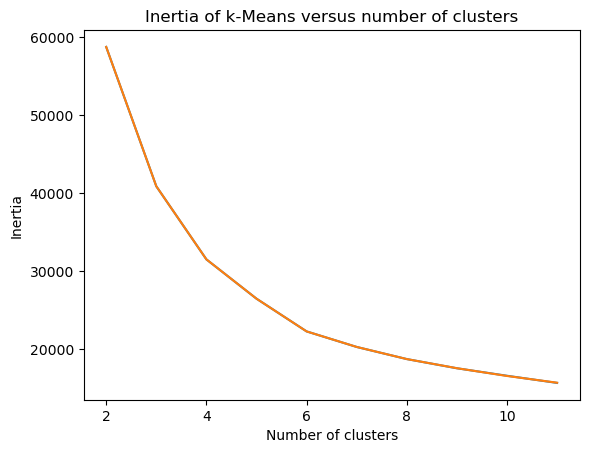

In [215]:
#Cantidad de n_clusters a elegir en el método de K-medias, variando de 2 a 11 clusters
scores = [KMeans(n_clusters=i).fit(X_projected).inertia_ for i in range(2,12)]

plt.plot(np.arange(2, 12), scores)
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")
plt.show()

Se deberían elegir 4 clusters en funcion del grafico anterior.

In [216]:

n_clust = 4

km = KMeans(n_clusters=n_clust, random_state=10)
km.fit(X_projected) #utiliza todas las habilidades: 34 dimensiones

# Recuperacion de etiquetas
clusters = km.labels_

Automatically created module for IPython interactive environment
Para n_clusters = 2 El silhouette_score promedio es : 0.4248496980695294
Para n_clusters = 3 El silhouette_score promedio es : 0.36666320318058093
Para n_clusters = 4 El silhouette_score promedio es : 0.3142934527774971
Para n_clusters = 5 El silhouette_score promedio es : 0.3169830285210546
Para n_clusters = 6 El silhouette_score promedio es : 0.30434188904813275


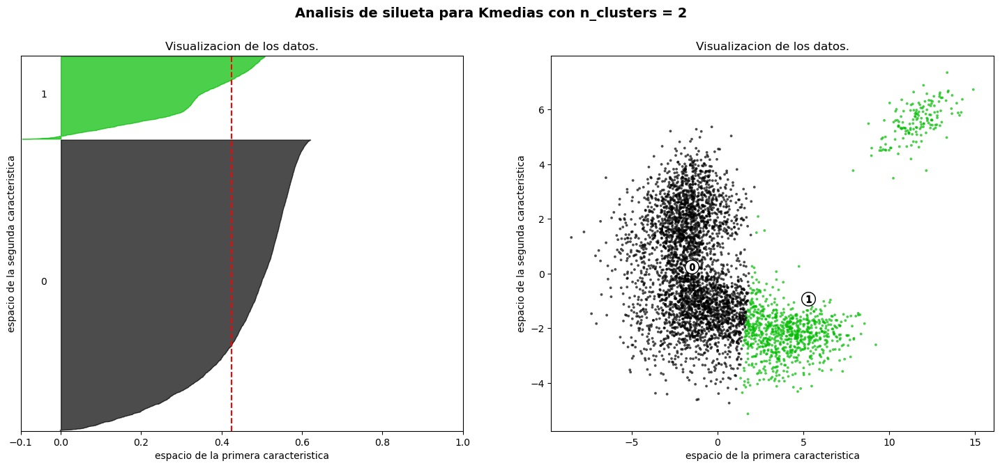

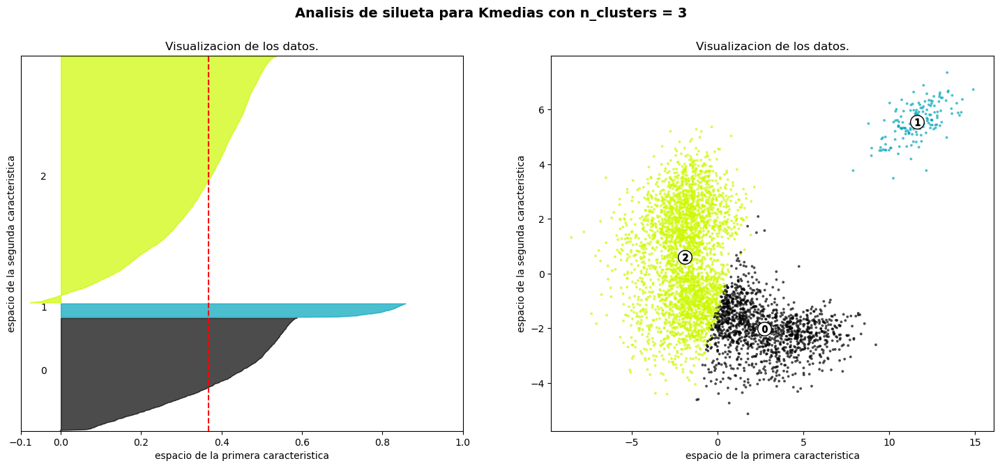

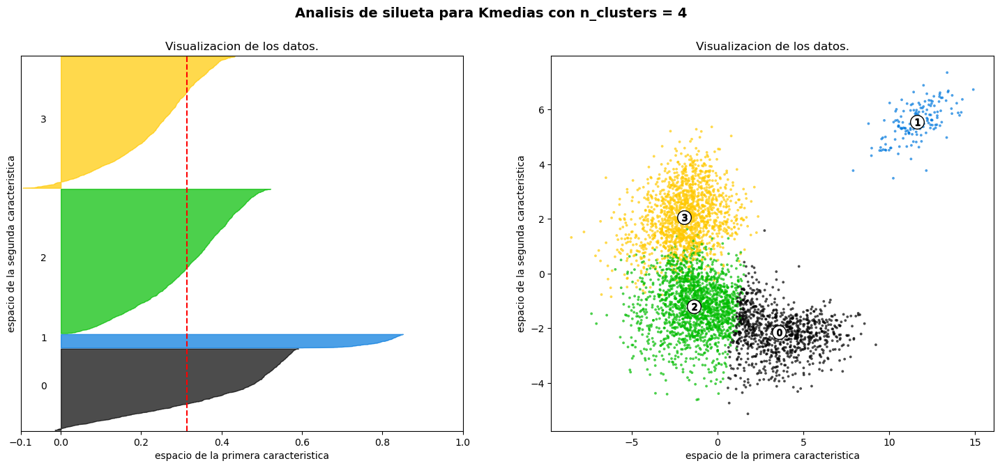

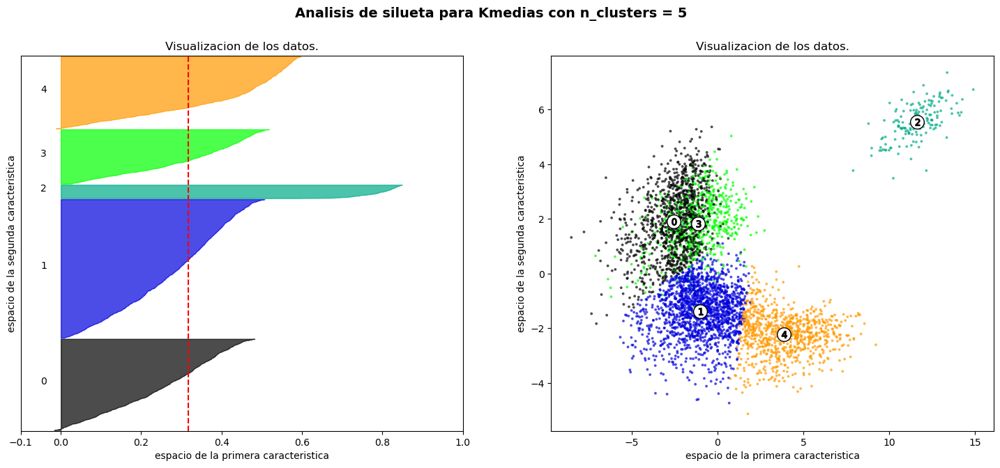

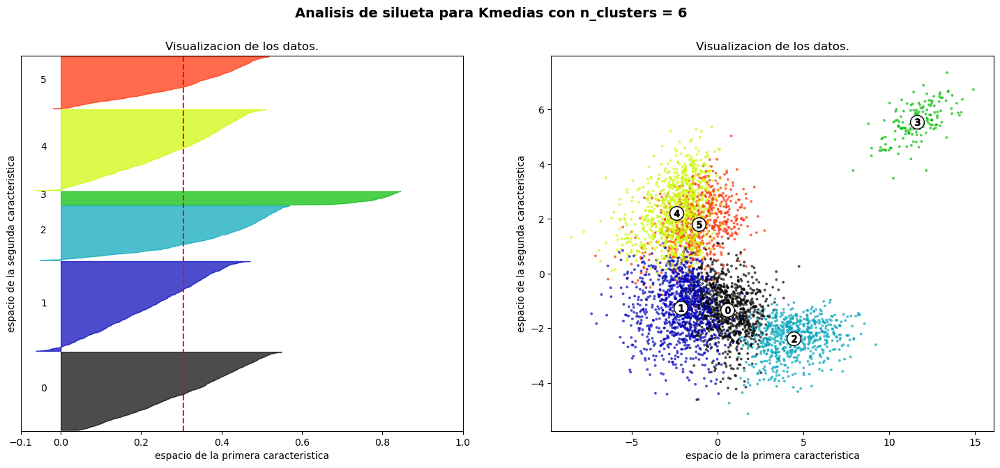

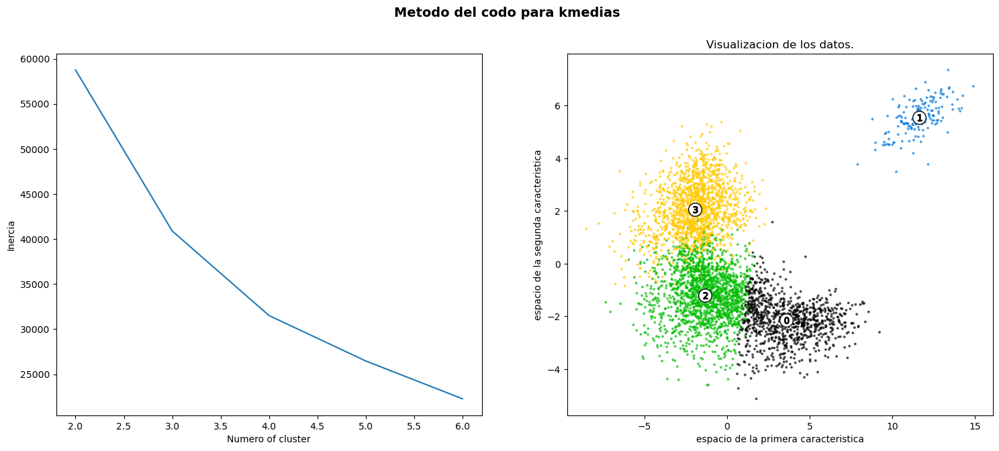

In [217]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

print(__doc__)

X=X_projected

range_n_clusters = [2,3, 4, 5, 6]
sse ={}
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)
    sse[n_clusters] = clusterer.inertia_

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("Para n_clusters =", n_clusters,
          "El silhouette_score promedio es :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("Visualizacion de los datos.")
    ax1.set_xlabel("espacio de la primera caracteristica")
    ax1.set_ylabel("espacio de la segunda caracteristica")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])


    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("Visualizacion de los datos.")
    ax2.set_xlabel("espacio de la primera caracteristica")
    ax2.set_ylabel("espacio de la segunda caracteristica")

    plt.suptitle(("Analisis de silueta para Kmedias "
                  "con n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')
    #plt.savefig("kmeans_%d" % n_clusters, dpi=300)

plt.show()

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(18, 7)
plt.suptitle(("Metodo del codo para kmedias "),
                 fontsize=14, fontweight='bold')
ax1.plot(list(sse.keys()), list(sse.values()))
ax1.set_xlabel("Numero of cluster")
ax1.set_ylabel("Inercia")

clusterer = KMeans(n_clusters=4, random_state=10)
cluster_labels = clusterer.fit_predict(X)
    
colors = cm.nipy_spectral(cluster_labels.astype(float) / 4)
ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,c=colors, edgecolor='k')

# Labeling the clusters
centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
ax2.scatter(centers[:, 0], centers[:, 1], marker='o',c="white", alpha=1, s=200, edgecolor='k')

for i, c in enumerate(centers):
    ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,s=50, edgecolor='k')

ax2.set_title("Visualizacion de los datos.")
ax2.set_xlabel("espacio de la primera caracteristica")
ax2.set_ylabel("espacio de la segunda caracteristica")

#plt.savefig("kmeans_elbow", dpi=300)
plt.show()

In [ ]:
Pareciera que el numero más apropiado de clusters es 4. 

In [218]:
n_clust = 4

km = KMeans(n_clusters=n_clust, random_state=10)
km.fit(X_projected) #utiliza todas las habilidades: 34 dimensiones

# Recuperacion de etiquetas
clusters = km.labels_
print('Suma de los cuadrados de las distancias al cluster=Inertia= ', km.inertia_)

Suma de los cuadrados de las distancias al cluster=Inertia=  31507.642095729276


In [219]:
data=[]
bool_crack=df_acp["overall"] > 85
bool_no_crack=df_acp["overall"]<86

kmean_clusters = go.Scatter(x=X_projected[:,0], y=X_projected[:,1],
                           mode='markers',
                        text=df_acp.loc[:,'short_name'],
                           marker=dict(
                                size=5,
                                color = clusters.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

acp_crack =go.Scatter(x=X_projected[bool_crack,0], y=X_projected[bool_crack,1],name='Top players',
                      text=df_acp.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[kmean_clusters,acp_crack]

layout = go.Layout(title="ACP + Clustering Mean Shift ",titlefont=dict(size=20),
                xaxis=dict(title='Componente 1'),
                yaxis=dict(title='Componente 2'),
                autosize=False, width=1000,height=1000)

fig = go.Figure(data=data, layout=layout)

plot(fig)

'temp-plot.html'

In [220]:
X = pd.DataFrame(X_projected)
X = X.rename(columns = {0: 'pca_1', 1: 'pca_2', 2: 'pca_3', 3: 'pca_4'}, inplace = False)

In [221]:
X["kmedias"] = km.labels_ #clusters

X.head(2)

,pca_1,pca_2,pca_3,pca_4,kmedias
0,-8.523387,1.322018,1.476308,0.746777,3
1,-6.384688,-0.202709,3.855610,-1.617228,3


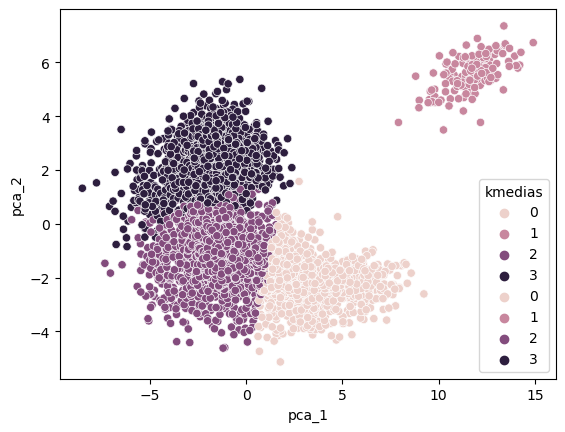

In [223]:
#Graficamos las dos primeras componentes, diferenciando por color los clusters encontrados
sns.scatterplot(data=X, x="pca_1", y="pca_2", hue="kmedias") 
plt.show()

A partir de las 4 componentes principales del pca pudimos obtener 4 clústers óptimos mediante el método de k-means, uno de ellos claramente más separado de los otros 3 (ver figura). Como vimos anteriormente, este grupo coincide con los jugadores que son arqueros y, como tales, poseen habilidades muy diferentes a los jugadores en otras posiciones.

### Meanshift

In [224]:
#Exploramos el número de clusters que se encuentran por medio del Método de MeanShift
ms = MeanShift( bin_seeding=True)

ms.fit(X_projected)

clusters2 = ms.labels_
cluster_centers = ms.cluster_centers_

labels_unique = np.unique(clusters2)
n_clusters_ = len(labels_unique)

print("Cantidad de clusters encontrados por Mean Shift : %d" % n_clusters_)
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X_projected, clusters2))

Cantidad de clusters encontrados por Mean Shift : 2
Silhouette Coefficient: 0.610


In [225]:
data=[]
bool_crack=df_acp["overall"] > 85
bool_no_crack=df_acp["overall"]<86

kmean_clusters = go.Scatter(x=X_projected[:,0], y=X_projected[:,1],
                           mode='markers',
                        text=df_acp.loc[:,'short_name'],
                           marker=dict(
                                size=5,
                                color = clusters2.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

acp_crack =go.Scatter(x=X_projected[bool_crack,0], y=X_projected[bool_crack,1],name='Top players',
                      text=df_acp.loc[bool_crack,'short_name'],
                      textfont=dict(family='sans serif',size=10,color='black'),
                      opacity=0.9,mode='text')

data=[kmean_clusters,acp_crack]

layout = go.Layout(title="ACP + Clustering Mean Shift ",titlefont=dict(size=20),
                xaxis=dict(title='Componente 1'),
                yaxis=dict(title='Componente 2'),
                autosize=False, width=1000,height=1000)

fig = go.Figure(data=data, layout=layout)

plot(fig)

'temp-plot.html'

In [226]:
X["mshift"] = ms.labels_ #clusters
X.head(2)

,pca_1,pca_2,pca_3,pca_4,kmedias,mshift
0,-8.523387,1.322018,1.476308,0.746777,3,0
1,-6.384688,-0.202709,3.855610,-1.617228,3,0


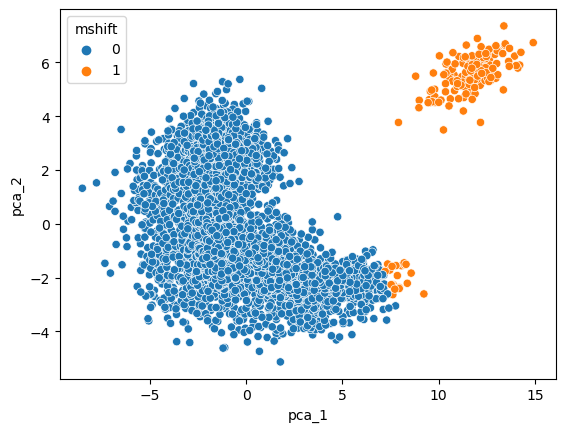

In [227]:
#Graficamos las dos primeras componentes, diferenciando por color los clusters encontrados por Mean Shift
sns.scatterplot(data=X, x="pca_1", y="pca_2", hue="mshift")  
plt.show()

Meanshift encuentró solamente dos clusters, uno de ellos visualmente separado en el espacio de las primeras dos componentes principales, con cierto solapamiento espacial con el otro cluster. Viendo ese gráfico, consideramos que es posible que este método no sea el más adecuado para el tipo de datos empleado.

### Conclusion

Como conclusión general, creemos haber entendido el dataset y el tipo de datos con el que trabajamos. Creemos que los arqueros, al poseer habilidades muy diferentes a los otros grupos, se pudieron diferenciar bien con todos los métodos. Sin embargo, los demás métodos difirieron en la clásificación de los jugadores restantes, como se pudo observar en el entregable. 
